実験
des mat to calc and metrix def

In [1]:
!ls "./201912_kyoto_uni_kurata_iryou/measurement/"

No10_OS2_050.CSV   No2_OS2_070.CSV    No5_OS2_070.CSV  No7_kobe050.CSV
No10_OS2_070.CSV   No2_OS2_080.CSV    No5_OS2_080.CSV  No7_kobe070.CSV
No10_OS2_080.CSV   No2_kobe070.CSV    No5_kobe070.CSV  No8_OS2_070.CSV
No10_kobe050.CSV   No3_OS2_070.CSV    No6_OS2_050.CSV  No8_OS2_080.CSV
No10_kobe070.CSV   No3_OS2_080.CSV    No6_OS2_070.CSV  No8_kobe050.CSV
No1_OS2_050.CSV    No3_kobe070.CSV    No6_OS2_080.CSV  No8_kobe070.CSV
No1_OS2_070.CSV    No4_OS2_070.CSV    No6_kobe050.CSV  No9_OS2_090.CSV
No1_OS2_090_X.CSV  No4_OS2_080.CSV    No6_kobe070.CSV  No9_kobe050.CSV
No1_kobe050.CSV    No4_OS2_090_X.CSV  No7_OS2_070.CSV  No9_kobe070.CSV
No1_kobe070.CSV    No4_kobe070.CSV    No7_OS2_080.CSV


In [2]:
import datetime

dt_now = datetime.datetime.now()
ts = dt_now.strftime('%Y%m%d_%H%M%S_%f')
ts

'20231229_175540_583251'

In [3]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing as hw
import os
import pandas as pd
import numpy as np
from scipy.signal import argrelmax, argrelmin
from matplotlib import pyplot as plt
import pickle

In [4]:
import pickle

def d2p(d, f):
    with open(f, 'wb') as file:
        pickle.dump(d, file)


def p2d(f):
    with open(f, 'rb') as file:
        d = pickle.load(file)
    return d

In [5]:
f_desmat = "../dat/design_matrix_pre_analysis.pkl"
df_desmat = pd.read_pickle(f_desmat)\
    .assign(is_rock_or_down = lambda df:df.movement.str.contains("ロッキング|転倒"))

df_desmat.head(50)

,number,experiment_number,accentulation_number,movie_number,seismic_wave,output,movement,備考,operating_table,mannequine_head,加震〜ロッキングまでの時間,time_to_rocking,position,Mizuho,堤動画,zval_ot,OT_tpye,floor,is_rock_or_down
1,1.0,1.0,No4_kobe070.CSV,1-12,Kobe,70.0,ロッキング,NaN,Ay1,Ay9,9秒,9.0,仰臥位,確認,確認,Ax2,OT-A,Concrete,True
2,2.0,1.0,No4_OS2_070.CSV,1-13,OS2,70.0,ロッキング,NaN,Ay1,Ay9,1分30秒,90.0,仰臥位,×,確認,Ax2,OT-A,Concrete,True
3,3.0,1.0,No4_OS2_080.CSV,1-14,OS2,80.0,ロッキング,NaN,Ay1,Ay9,1分30秒,90.0,仰臥位,確認,確認,Ax2,OT-A,Concrete,True
4,4.0,1.0,No4_OS2_090_X.CSV,1-15,OS2,90.0,転倒,NaN,Ay1,Ay9,1分20秒,80.0,仰臥位,×,確認,Ax2,OT-A,Concrete,True
5,5.0,2.0,No5_kobe070.CSV,1-16,Kobe,70.0,ロッキング,NaN,Ay1,Ay9,12秒,12.0,頭低位,×,確認,Ax2,OT-A,Concrete,True
6,6.0,2.0,No5_OS2_070.CSV,1-17,OS2,70.0,なし,NaN,Ay1,Ay9,なし,NaN,頭低位,×,確認,Ax2,OT-A,Concrete,False
7,7.0,2.0,No5_OS2_080.CSV,1-18,OS2,80.0,ロッキング,NaN,Ay1,Ay9,1分19秒,79.0,頭低位,×,確認,Ax2,OT-A,Concrete,True
8,8.0,3.0,No7_kobe070.CSV,2-7,Kobe,70.0,なし,NaN,Ay1,Ay9,なし,NaN,頭低位,×,確認,Ax2,OT-B,Concrete,False
9,9.0,3.0,No7_OS2_070.CSV,2-8,OS2,70.0,なし,NaN,Ay1,Ay9,NaN,NaN,頭低位,×,確認,Ax2,OT-B,Concrete,False
10,10.0,3.0,No7_OS2_080.CSV,2-9,OS2,80.0,なし,柵に当たる,Ay1,Ay9,NaN,NaN,頭低位,×,確認,Ax2,OT-B,Concrete,False


In [6]:
eval_tag = df_desmat["accentulation_number"].to_list()
eval_tag = [i.replace(".CSV", "") for i in eval_tag]
eval_tag

['No4_kobe070',
 'No4_OS2_070',
 'No4_OS2_080',
 'No4_OS2_090_X',
 'No5_kobe070',
 'No5_OS2_070',
 'No5_OS2_080',
 'No7_kobe070',
 'No7_OS2_070',
 'No7_OS2_080',
 'No8_kobe070',
 'No8_OS2_070',
 'No8_OS2_080',
 'No6_kobe070',
 'No6_OS2_070',
 'No6_OS2_080']

In [7]:
len(eval_tag)

16

In [8]:
def get_vel_from_acc(data):
    #台形積分
    filterCoefficient = 10e-8 #0.9
    lowpassValue = 0.
    highpassValue = 0.
    oldAccel = 0.

    timeSpan = 0.005
    speed = 0
    oldSpeed = 0

    #0.05秒ごとの加速度を足し合わせ、0.05秒をかける。0．０１かけているのはGal→m/ssに変換するため

    data_velocity = []

    for i in range(len(data)):

        # ローパスフィルター(現在の値 = 係数 * ひとつ前の値 ＋ (1 - 係数) * センサの値)
        lowpassValue = lowpassValue * filterCoefficient + data[i] * (1 - filterCoefficient)
        # ハイパスフィルター(センサの値 - ローパスフィルターの値)
        highpassValue = data[i] - lowpassValue

        # 速度計算(加速度を台形積分する)
        speed = ((highpassValue + oldAccel) * timeSpan * 0.01) / 2 + speed

        data_velocity.append(speed)
    
    return np.array(data_velocity)

In [9]:
def fill_arr_zero(arr, start, end):
    arr_f = arr.copy()
    arr_f[:start] = 0
    arr_f[end:] = 0
    return arr_f

In [10]:
def get_max_abs_pos(arr):
    res = dict()
    max_abs = np.max(np.abs(arr))
    max_abs_ind  = np.argmax(np.abs(arr))
    max_val = arr[max_abs_ind]
    res["max_abs"] = max_abs
    res["max_abs_ind"] = max_abs_ind
    res["max_val"] = max_val
    res["pos"] = (max_abs_ind, max_val)
    return res

In [11]:
# arr = vel_sty_lim

In [12]:
# v = dict()
# loc_max = argrelmax(arr, order=25)
# loc_min = argrelmin(arr, order=25)

# loc_max_y = arr[loc_max]
# loc_min_y = arr[loc_min]

# v["loc_max"] = loc_max
# v["loc_min"] = loc_min

# v["loc_max_y"] = loc_max_y
# v["loc_min_y"] = loc_min_y


# df_i_max = pd.DataFrame().from_dict(
#     {"x":loc_max[0],
#      "y":loc_max_y
#     })\
# .assign(categ = "max")

# df_i_min = pd.DataFrame().from_dict(
#     {"x":loc_min[0],
#      "y":loc_min_y})\
#     .assign(categ = "min")

# df_i = pd.concat([df_i_max, df_i_min])\
#     .sort_values("x")\
#     .reset_index(drop=True)\
#     .assign(lag_cat = lambda df:df.categ.shift(1))\
#     .assign(lead_cat = lambda df:df.categ.shift(-1))\
#     .assign(lag_x = lambda df:df.x.shift(1))\
#     .assign(ind =lambda df:df.index +1)\
#     .assign(lag_ind =lambda df:[r.ind if r.categ != r.lag_cat else np.NaN for r in df.itertuples()])\
#     .assign(is_same_lead = lambda df:df.categ == df.lag_cat)\
#     .assign(lag_ind = lambda df:df.lag_ind.fillna(method ="ffill").astype(int))\
#     .assign(loc_max = lambda df:df.groupby(["lag_ind"])["y"].transform(lambda x:max(x)))\
#     .assign(loc_min = lambda df:df.groupby(["lag_ind"])["y"].transform(lambda x:min(x)))\
#     .assign(loc_val = lambda df:[r.loc_max if r.categ == "max" else r.loc_min for r in df.itertuples()])\
#     .query("y == loc_val")\
#     .assign(lag_y = lambda df:df.y.shift(1))\
#     .assign(lag_x = lambda df:df.x.shift(1))\
#     .assign(sub_min_max = lambda df:df.y - df.lag_y)\
#     .assign(abs_sub_min_max = lambda df:np.abs(df.sub_min_max),
#             max_abs_sub_min_max = lambda df:df.abs_sub_min_max.max()) \
#     .query("abs_sub_min_max == max_abs_sub_min_max")


In [13]:
# df_i

In [14]:
def get_max_change(arr):
    v = dict()
    loc_max = argrelmax(arr, order=25)
    loc_min = argrelmin(arr, order=25)
    
    loc_max_y = arr[loc_max]
    loc_min_y = arr[loc_min]
    
    v["loc_max"] = loc_max
    v["loc_min"] = loc_min
    
    v["loc_max_y"] = loc_max_y
    v["loc_min_y"] = loc_min_y
    
    
    df_i_max = pd.DataFrame().from_dict(
    {"x":loc_max[0],
     "y":loc_max_y
    })\
    .assign(categ = "max")

    df_i_min = pd.DataFrame().from_dict(
        {"x":loc_min[0],
         "y":loc_min_y})\
        .assign(categ = "min")

    df_i = pd.concat([df_i_max, df_i_min])\
        .sort_values("x")\
        .reset_index(drop=True)\
        .assign(lag_cat = lambda df:df.categ.shift(1))\
        .assign(lead_cat = lambda df:df.categ.shift(-1))\
        .assign(lag_x = lambda df:df.x.shift(1))\
        .assign(ind =lambda df:df.index +1)\
        .assign(lag_ind =lambda df:[r.ind if r.categ != r.lag_cat else np.NaN for r in df.itertuples()])\
        .assign(is_same_lead = lambda df:df.categ == df.lag_cat)\
        .assign(lag_ind = lambda df:df.lag_ind.fillna(method ="ffill").astype(int))\
        .assign(loc_max = lambda df:df.groupby(["lag_ind"])["y"].transform(lambda x:max(x)))\
        .assign(loc_min = lambda df:df.groupby(["lag_ind"])["y"].transform(lambda x:min(x)))\
        .assign(loc_val = lambda df:[r.loc_max if r.categ == "max" else r.loc_min for r in df.itertuples()])\
        .query("y == loc_val")\
        .assign(lag_y = lambda df:df.y.shift(1))\
        .assign(lag_x = lambda df:df.x.shift(1))\
        .assign(sub_min_max = lambda df:df.y - df.lag_y)\
        .assign(abs_sub_min_max = lambda df:np.abs(df.sub_min_max),
                max_abs_sub_min_max = lambda df:df.abs_sub_min_max.max()) \
        .query("abs_sub_min_max == max_abs_sub_min_max")

    seg_x = [df_i["x"], df_i["lag_x"]]
    seg_y = [df_i["y"], df_i["lag_y"]]

    v["d_max_dif"] = df_i.reset_index(drop=True).loc[0].to_dict()
    
    v["seg_x"] = seg_x
    v["seg_y"] = seg_y
    v["locs"] = {
        "max":{
            "x":loc_max[0],
            "y":loc_max_y
        },
        "min":{
            "x":loc_min[0],
            "y":loc_min_y
        }
    }
    
    return v

In [15]:
def vis_acc_abs_mx(arr, max_pos=None, span_range=None, label="",ylim=None, opt_point = None):
    plt.rcParams['figure.figsize'] = [35, 9]
    plt.rcParams['axes.xmargin'] = 0
    plt.plot(arr)
    
    if max_pos is not None:
        plt.plot(max_pos[0],max_pos[1], "o")
    if opt_point is not None:
        plt.plot(opt_point[0], opt_point[1], "o", color ="blue")
    if span_range is not None:
        plt.plot(span_range, (0,0), color="red")
    
    if ylim is not None:
        #plt.ylim(ylim[0], ylim[1])
        plt.ylim(*ylim)
    
    plt.show()


In [16]:
def vis_mv_change(arr, seg =None, locs = None,span_range=None, label= "", ylim=None, opt_seg = None):
    plt.rcParams['figure.figsize'] = [35, 9]
    plt.rcParams['axes.xmargin'] = 0
    plt.plot(arr)
    
    if locs is not None:
        loc_max_x = locs["max"]["x"]
        loc_max_y = locs["max"]["y"]
        loc_min_x = locs["min"]["x"]
        loc_min_y = locs["min"]["y"]
        plt.plot(loc_max_x, loc_max_y, "o")
        plt.plot(loc_min_x, loc_min_y, "o")
    
    if seg is not None:
        plt.plot(seg[0], seg[1], color="black")
    if opt_seg is not None:
        plt.plot(opt_seg[0], opt_seg[1], color="blue")
    if span_range is not None:
        plt.plot(span_range, (0,0), color="red")
    if ylim is not None:
        #plt.ylim(ylim[0], ylim[1])
        plt.ylim(*ylim)
    
    
    plt.show()

In [17]:
def get_abs_above_x_1st(arr, cutoff):
    arr_abs = np.abs(arr)
    index = np.argmax(arr_abs > cutoff)
    return index

In [18]:
get_abs_above_x_1st(np.array([1,2,3,300, 400, 300, 200, 1]), 199)

3

In [19]:
np.abs([1,2,3,-1,-2,-3]) >= 5

array([False, False, False, False, False, False])

In [20]:
np.argmax(np.abs([1,2,3,-1,-2,-3]) >= 0)

0

{'Index': 1, 'number': 1.0, 'experiment_number': 1.0, 'accentulation_number': 'No4_kobe070.CSV', 'movie_number': '1-12', 'seismic_wave': 'Kobe', 'output': 70.0, 'movement': 'ロッキング', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': '9秒', 'time_to_rocking': 9.0, 'position': '仰臥位', 'Mizuho': '確認', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-A', 'floor': 'Concrete', 'is_rock_or_down': True}
eval_span:1.22_5.81
eval_ind:244_1162
time to rock:4.59
m_head max_pos:(1129, 862.776)
m_head_whole max_pos:(2138, -4382.73)


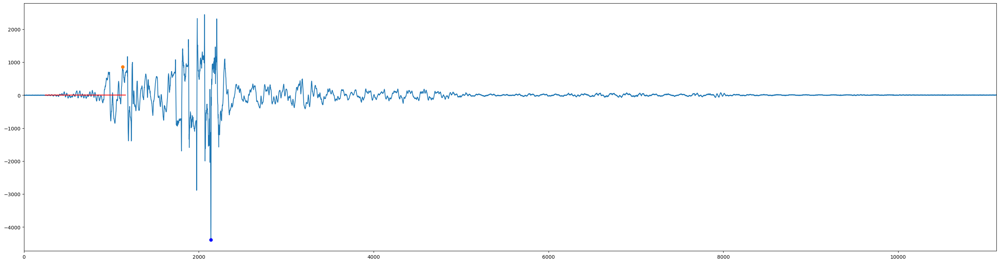

ot max_pos:(1020, 666.115)
ot_whole max_pos:(1974, -7187.79)


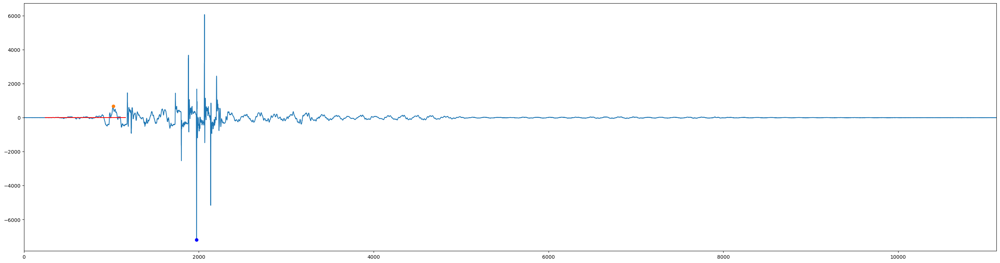

otz max_pos:(1047, 85.4795)
rock_pos:(1182, 309.594)
shake_pos:(244, 1182)


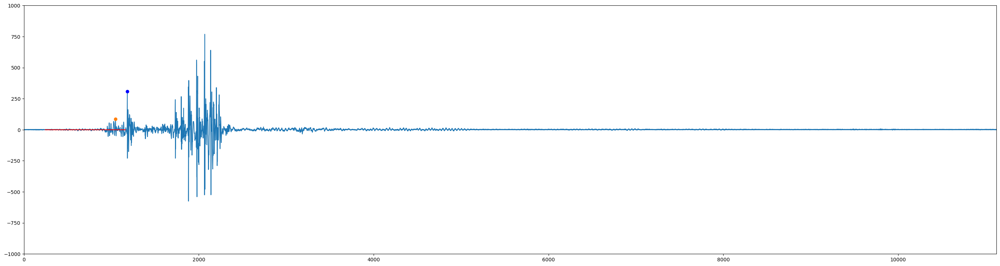

syt max_pos:(1016, 650.25)
syt start/end_pos:(244, 1162)


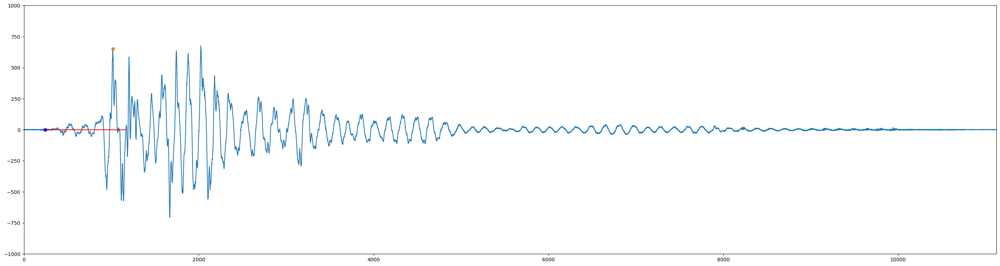

m_head_vel max_dif:([25    993
Name: x, dtype: int64, 25    966.0
Name: lag_x, dtype: float64], [25   -1.959845e-09
Name: y, dtype: float64, 25    1.751648e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([77    2205
Name: x, dtype: int64, 77    2138.0
Name: lag_x, dtype: float64], [77    5.787925e-09
Name: y, dtype: float64, 77   -1.095683e-08
Name: lag_y, dtype: float64])


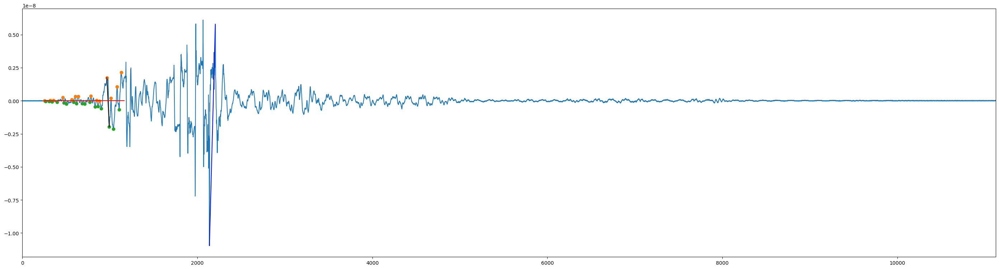

ot_vel max_dif:
ot_vel_whole max_dif:


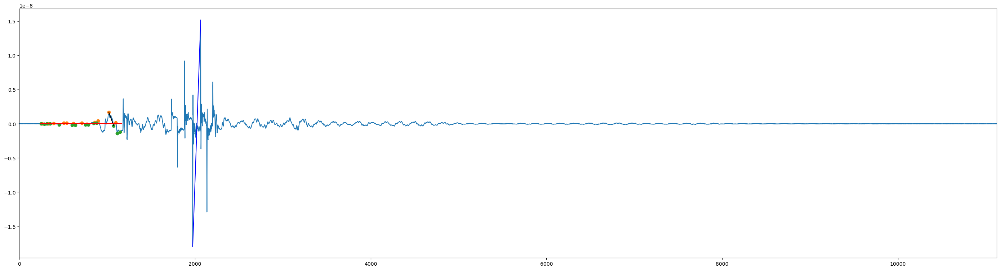

sty_vel_whole max_dif:


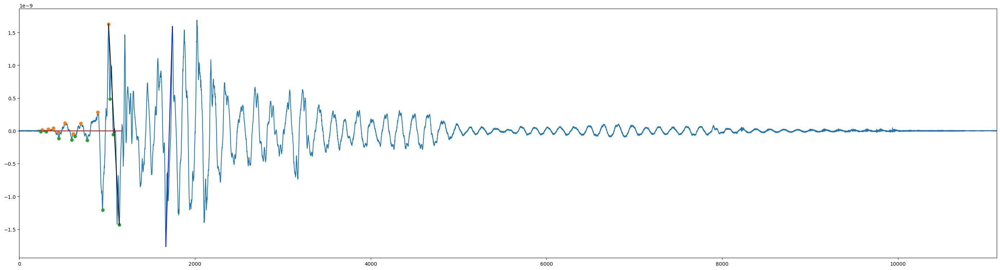

{'Index': 2, 'number': 2.0, 'experiment_number': 1.0, 'accentulation_number': 'No4_OS2_070.CSV', 'movie_number': '1-13', 'seismic_wave': 'OS2', 'output': 70.0, 'movement': 'ロッキング', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': '1分30秒', 'time_to_rocking': 90.0, 'position': '仰臥位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-A', 'floor': 'Concrete', 'is_rock_or_down': True}
eval_span:0.16_87.575
eval_ind:32_17515
time to rock:87.415
m_head max_pos:(14902, -821.692)
m_head_whole max_pos:(17844, -2867.04)


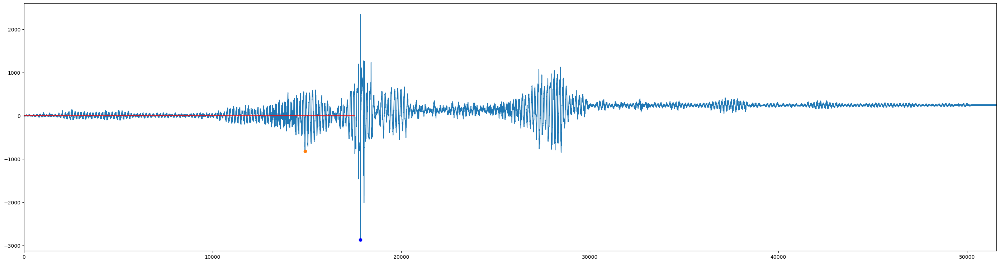

ot max_pos:(14887, 514.448)
ot_whole max_pos:(17843, -5349.5)


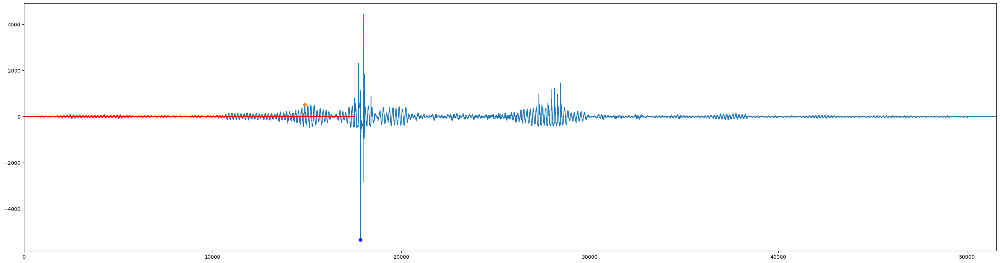

otz max_pos:(17359, -69.6766)
rock_pos:(17535, -201.128)
shake_pos:(32, 17535)


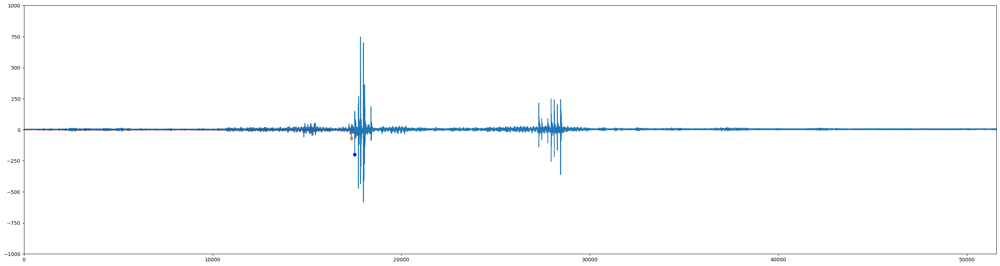

syt max_pos:(17486, -464.25)
syt start/end_pos:(32, 17515)


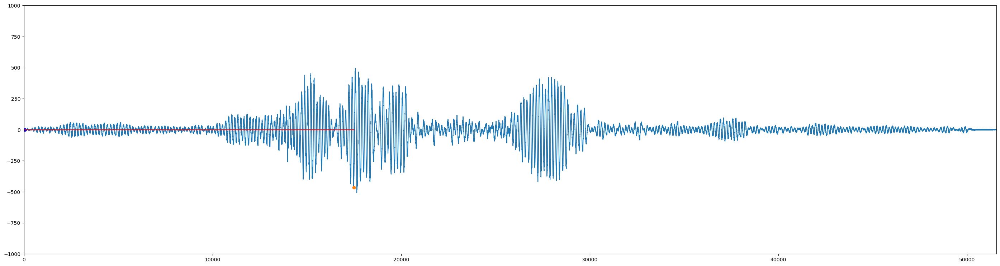

m_head_vel max_dif:([521    14978
Name: x, dtype: int64, 521    14902.0
Name: lag_x, dtype: float64], [521    1.318593e-09
Name: y, dtype: float64, 521   -2.054230e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([591    17851
Name: x, dtype: int64, 591    17844.0
Name: lag_x, dtype: float64], [591    5.846225e-09
Name: y, dtype: float64, 591   -7.167601e-09
Name: lag_y, dtype: float64])


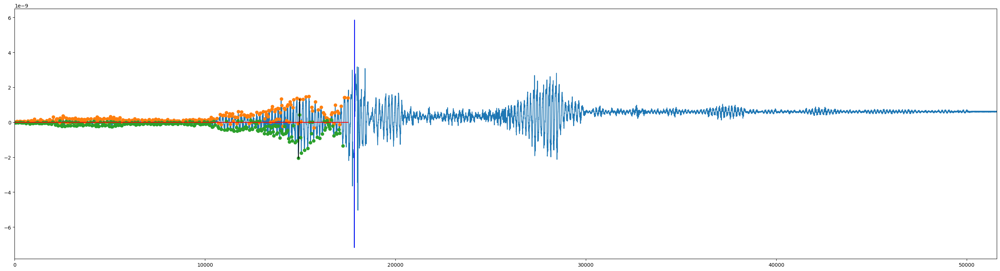

ot_vel max_dif:
ot_vel_whole max_dif:


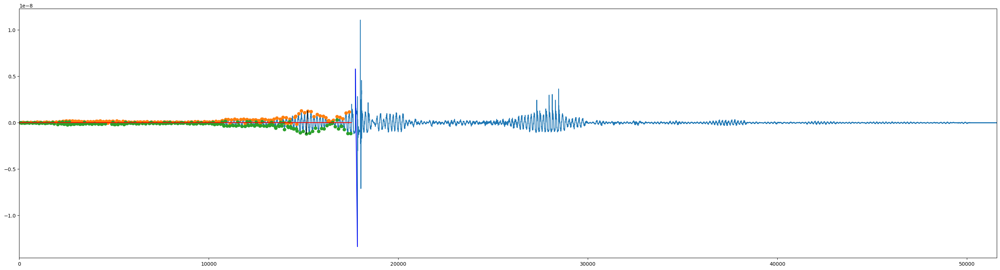

sty_vel_whole max_dif:


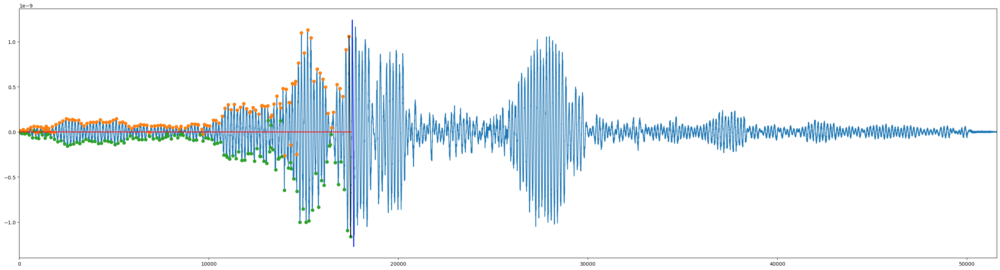

{'Index': 3, 'number': 3.0, 'experiment_number': 1.0, 'accentulation_number': 'No4_OS2_080.CSV', 'movie_number': '1-14', 'seismic_wave': 'OS2', 'output': 80.0, 'movement': 'ロッキング', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': '1分30秒', 'time_to_rocking': 90.0, 'position': '仰臥位', 'Mizuho': '確認', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-A', 'floor': 'Concrete', 'is_rock_or_down': True}
eval_span:0.545_87.75
eval_ind:109_17550
time to rock:87.205
m_head max_pos:(17466, 1417.97)
m_head_whole max_pos:(18368, -3656.53)


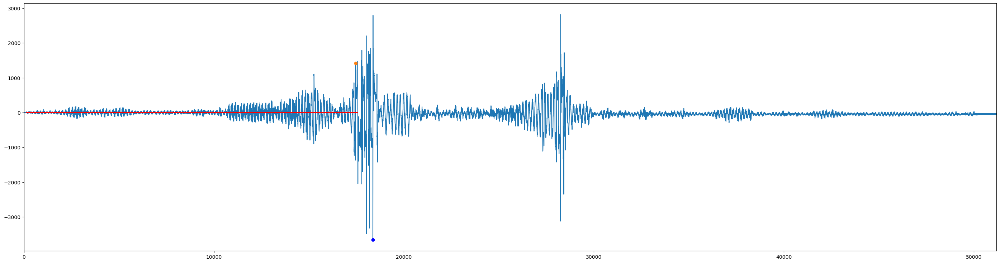

ot max_pos:(17457, -1443.5)
ot_whole max_pos:(18036, -7523.14)


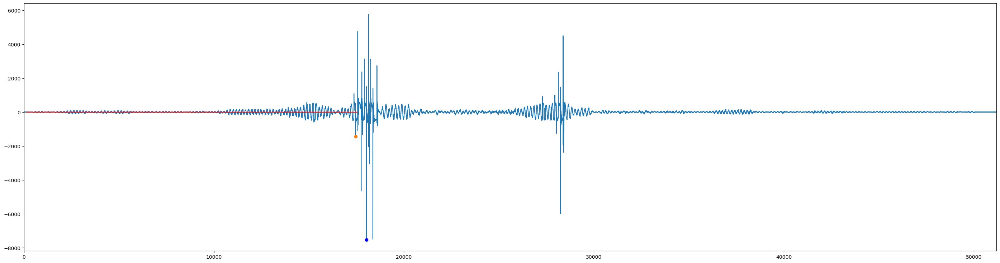

otz max_pos:(17381, 177.424)
rock_pos:(17570, 672.343)
shake_pos:(109, 17570)


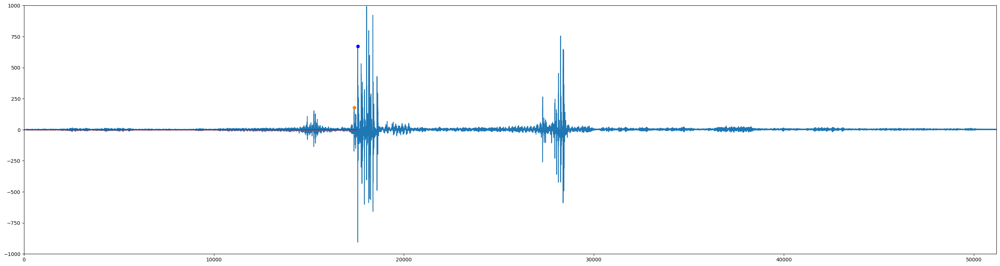

syt max_pos:(14887, 514.875)
syt start/end_pos:(109, 17550)


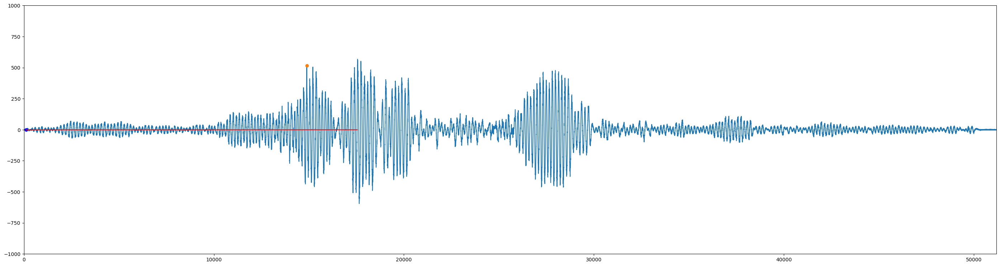

m_head_vel max_dif:([596    17466
Name: x, dtype: int64, 596    17456.0
Name: lag_x, dtype: float64], [596    3.544925e-09
Name: y, dtype: float64, 596   -3.425575e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([629    18375
Name: x, dtype: int64, 629    18368.0
Name: lag_x, dtype: float64], [629    6.981601e-09
Name: y, dtype: float64, 629   -9.141325e-09
Name: lag_y, dtype: float64])


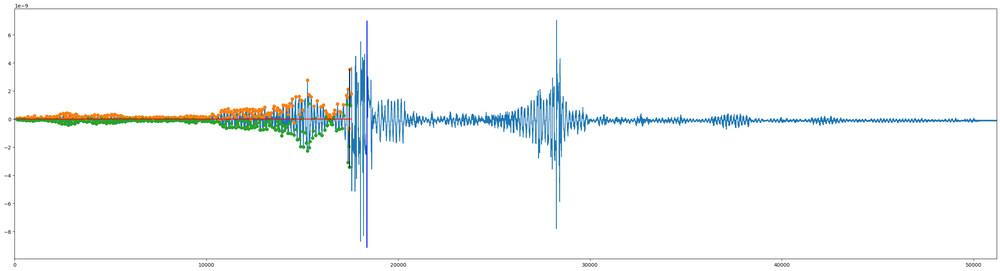

ot_vel max_dif:
ot_vel_whole max_dif:


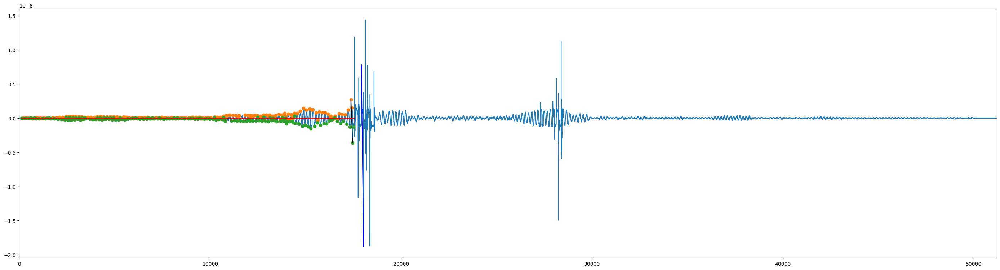

sty_vel_whole max_dif:


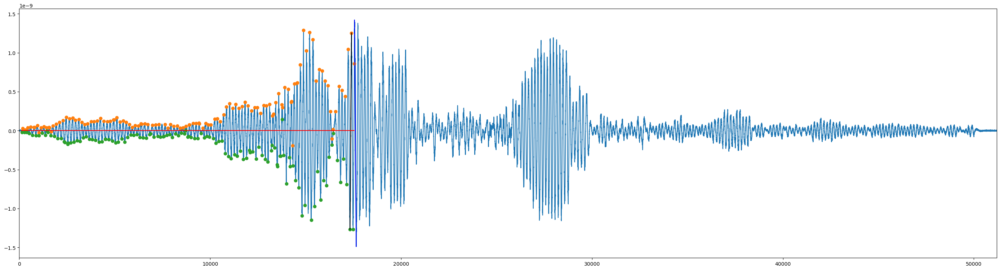

{'Index': 4, 'number': 4.0, 'experiment_number': 1.0, 'accentulation_number': 'No4_OS2_090_X.CSV', 'movie_number': '1-15', 'seismic_wave': 'OS2', 'output': 90.0, 'movement': '転倒', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': '1分20秒', 'time_to_rocking': 80.0, 'position': '仰臥位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-A', 'floor': 'Concrete', 'is_rock_or_down': True}
eval_span:0.255_74.16
eval_ind:51_14832
time to rock:73.905
m_head max_pos:(14732, -716.204)
m_head_whole max_pos:(15752, 11005.1)


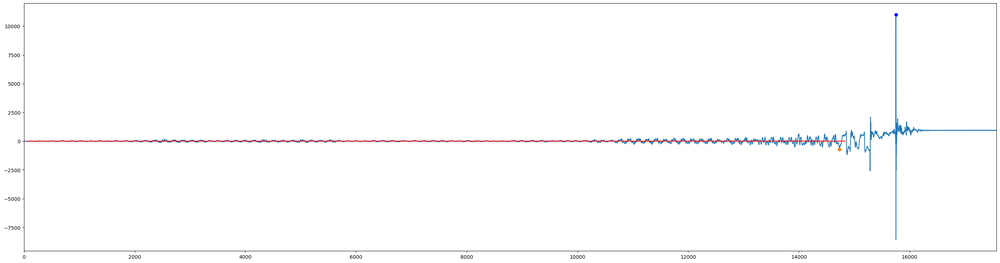

ot max_pos:(14822, -497.681)
ot_whole max_pos:(15284, -3889.23)


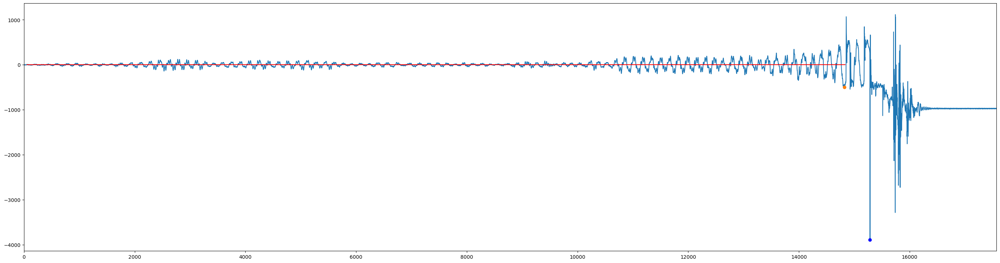

otz max_pos:(14798, -48.1271)
rock_pos:(14852, 224.114)
shake_pos:(51, 14852)


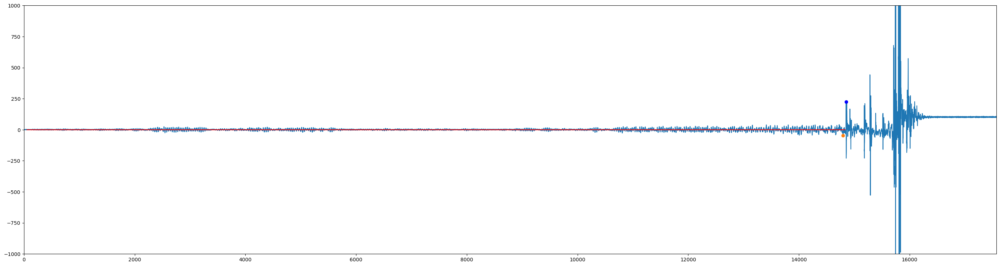

syt max_pos:(14807, -488.25)
syt start/end_pos:(51, 14832)


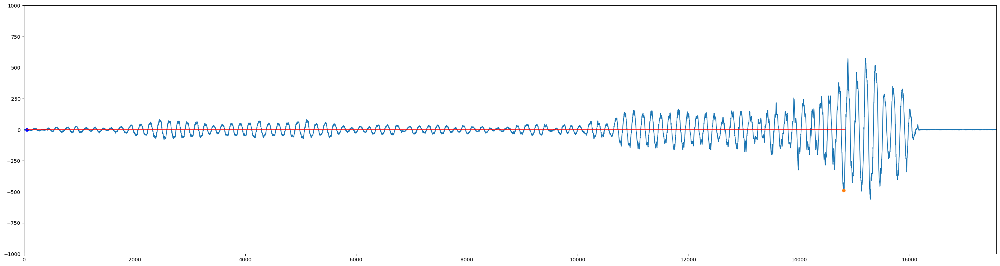

m_head_vel max_dif:([512    14732
Name: x, dtype: int64, 512    14661.0
Name: lag_x, dtype: float64], [512   -1.790510e-09
Name: y, dtype: float64, 512    1.460168e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([544    15753
Name: x, dtype: int64, 544    15752.0
Name: lag_x, dtype: float64], [544   -2.142227e-08
Name: y, dtype: float64, 544    2.751275e-08
Name: lag_y, dtype: float64])


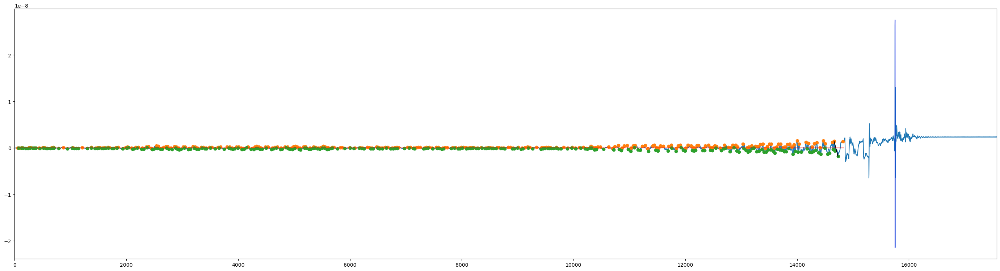

ot_vel max_dif:
ot_vel_whole max_dif:


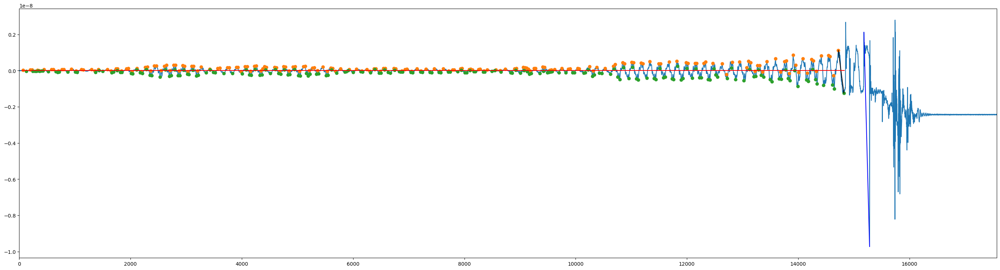

sty_vel_whole max_dif:


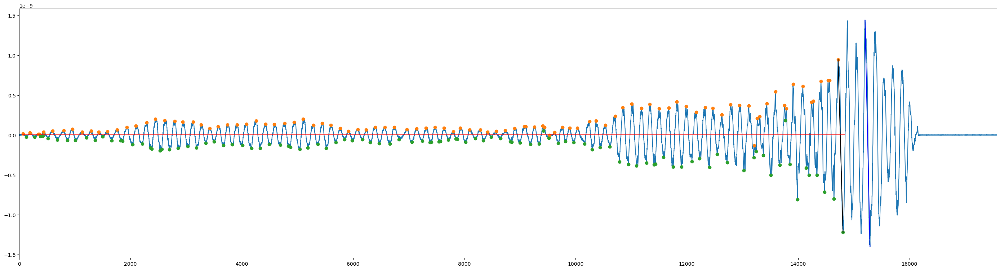

{'Index': 5, 'number': 5.0, 'experiment_number': 2.0, 'accentulation_number': 'No5_kobe070.CSV', 'movie_number': '1-16', 'seismic_wave': 'Kobe', 'output': 70.0, 'movement': 'ロッキング', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': '12秒', 'time_to_rocking': 12.0, 'position': '頭低位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-A', 'floor': 'Concrete', 'is_rock_or_down': True}
eval_span:1.085_5.25
eval_ind:217_1050
time to rock:4.165
m_head max_pos:(1035, -929.4)
m_head_whole max_pos:(2182, 2945.88)


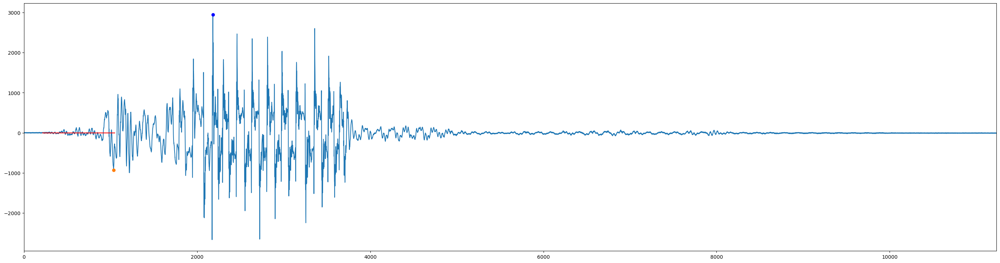

ot max_pos:(1021, 618.1)
ot_whole max_pos:(2172, -6446.99)


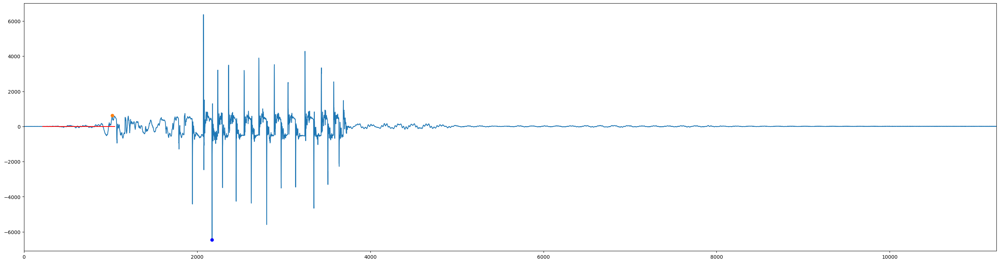

otz max_pos:(1027, 104.874)
rock_pos:(1070, 226.988)
shake_pos:(217, 1070)


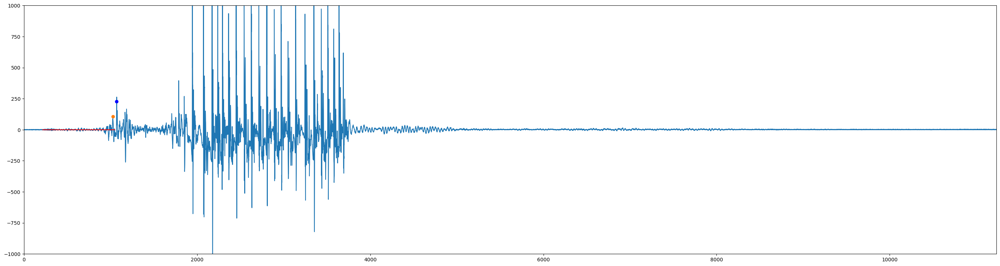

syt max_pos:(1016, 635.625)
syt start/end_pos:(217, 1050)


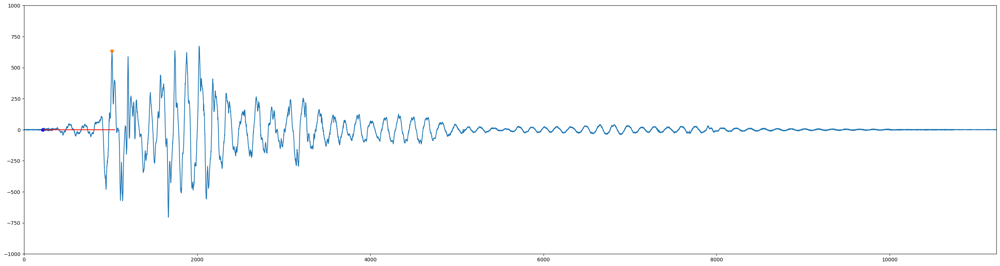

m_head_vel max_dif:([30    996
Name: x, dtype: int64, 30    968.0
Name: lag_x, dtype: float64], [30   -1.462945e-09
Name: y, dtype: float64, 30    1.396320e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([81    2182
Name: x, dtype: int64, 81    2173.0
Name: lag_x, dtype: float64], [81    7.364701e-09
Name: y, dtype: float64, 81   -6.659600e-09
Name: lag_y, dtype: float64])


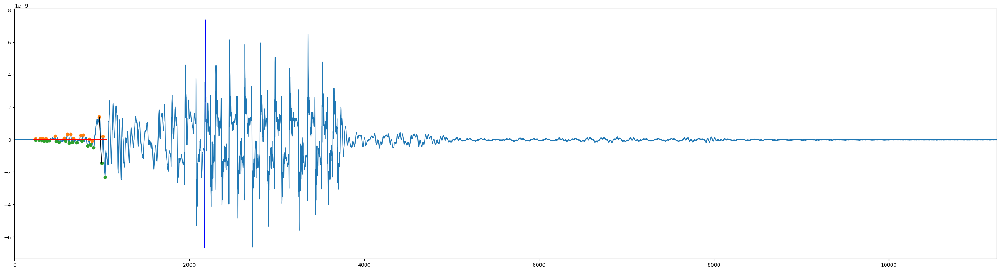

ot_vel max_dif:
ot_vel_whole max_dif:


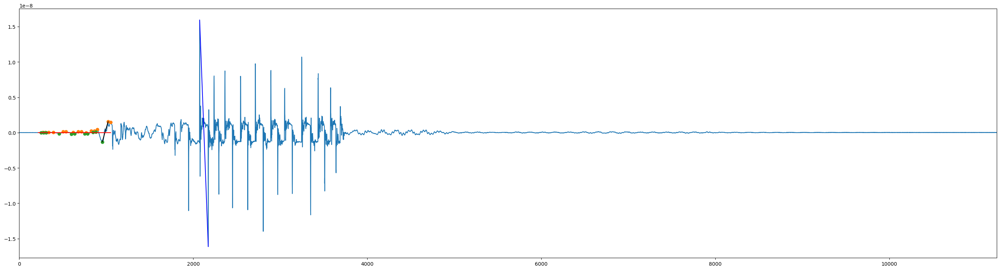

sty_vel_whole max_dif:


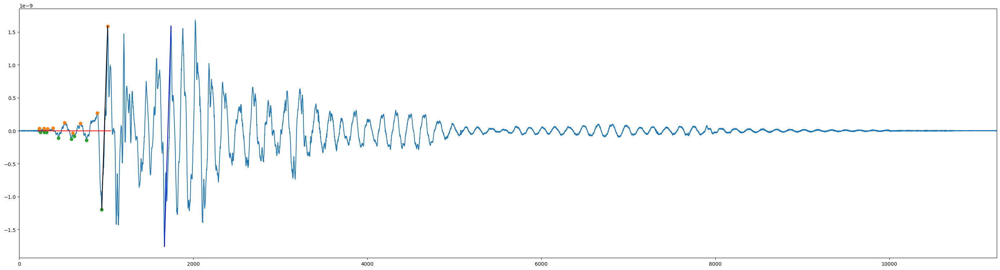

{'Index': 6, 'number': 6.0, 'experiment_number': 2.0, 'accentulation_number': 'No5_OS2_070.CSV', 'movie_number': '1-17', 'seismic_wave': 'OS2', 'output': 70.0, 'movement': 'なし', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': 'なし', 'time_to_rocking': nan, 'position': '頭低位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-A', 'floor': 'Concrete', 'is_rock_or_down': False}
eval_span:0.0_256.925
eval_ind:0_51385
time to rock:256.925
m_head max_pos:(17635, 1144.82)
m_head_whole max_pos:(17635, 1144.82)


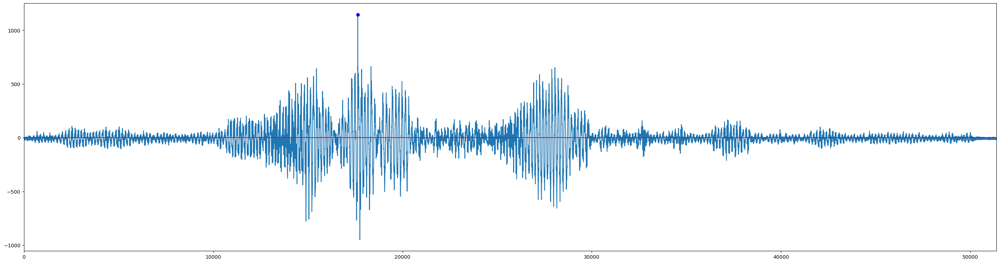

ot max_pos:(17624, -806.35)
ot_whole max_pos:(17624, -806.35)


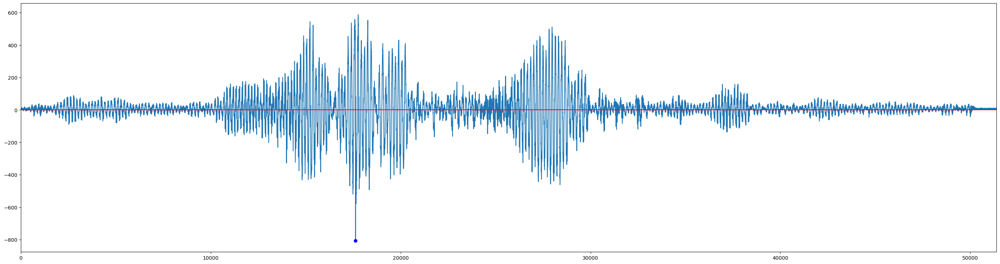

otz max_pos:(17619, 295.946)


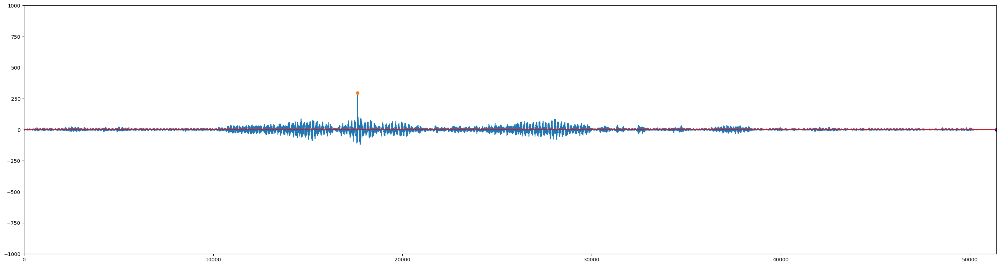

syt max_pos:(17647, -511.5)
syt start/end_pos:(0, 51385)


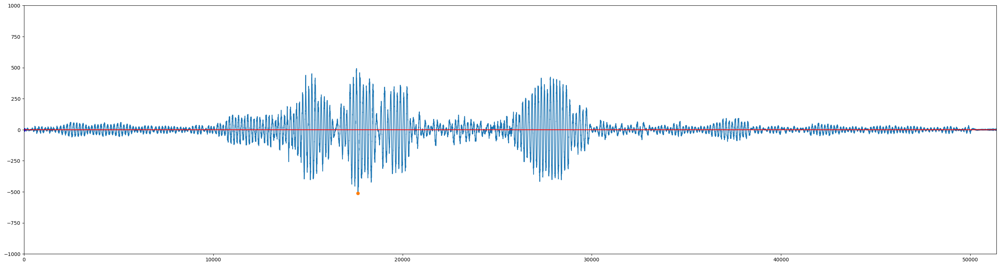

m_head_vel max_dif:([585    17747
Name: x, dtype: int64, 585    17635.0
Name: lag_x, dtype: float64], [585   -2.373468e-09
Name: y, dtype: float64, 585    2.862050e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([585    17747
Name: x, dtype: int64, 585    17635.0
Name: lag_x, dtype: float64], [585   -2.373468e-09
Name: y, dtype: float64, 585    2.862050e-09
Name: lag_y, dtype: float64])


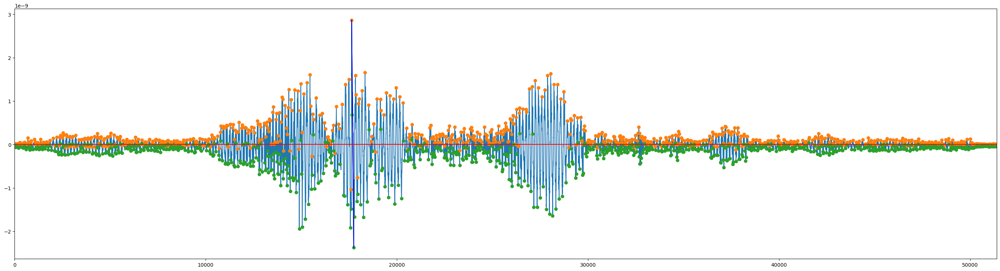

ot_vel max_dif:
ot_vel_whole max_dif:


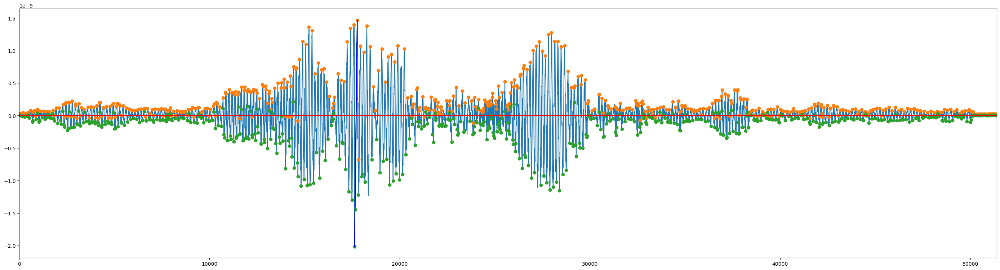

sty_vel_whole max_dif:


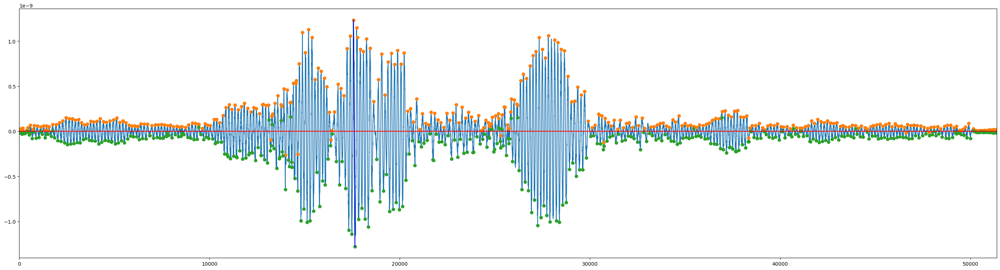

{'Index': 7, 'number': 7.0, 'experiment_number': 2.0, 'accentulation_number': 'No5_OS2_080.CSV', 'movie_number': '1-18', 'seismic_wave': 'OS2', 'output': 80.0, 'movement': 'ロッキング', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': '1分19秒', 'time_to_rocking': 79.0, 'position': '頭低位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-A', 'floor': 'Concrete', 'is_rock_or_down': True}
eval_span:0.56_76.195
eval_ind:112_15239
time to rock:75.63499999999999
m_head max_pos:(15055, -868.328)
m_head_whole max_pos:(18394, 3779.78)


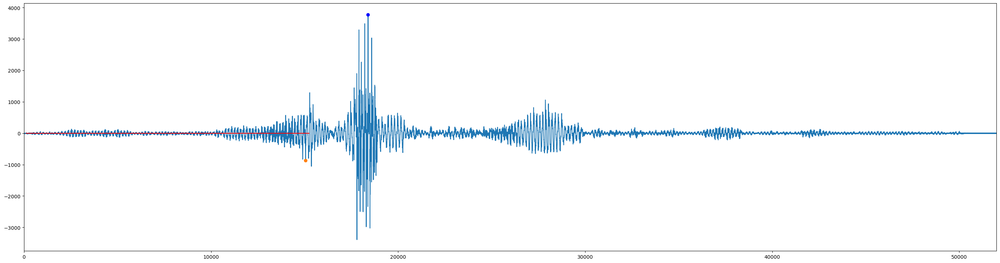

ot max_pos:(14892, 562.463)
ot_whole max_pos:(18385, -7481.22)


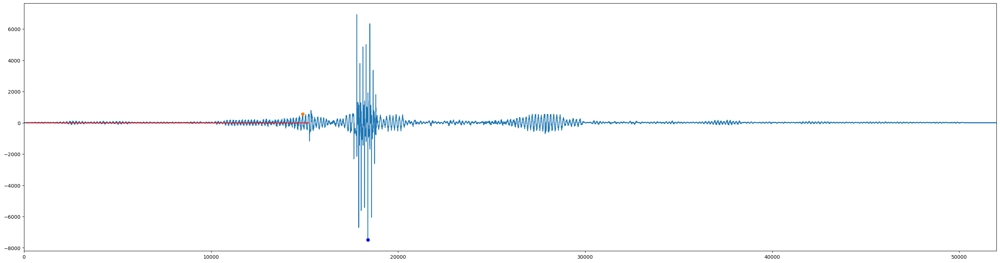

otz max_pos:(14941, -111.339)
rock_pos:(15259, 301.692)
shake_pos:(112, 15259)


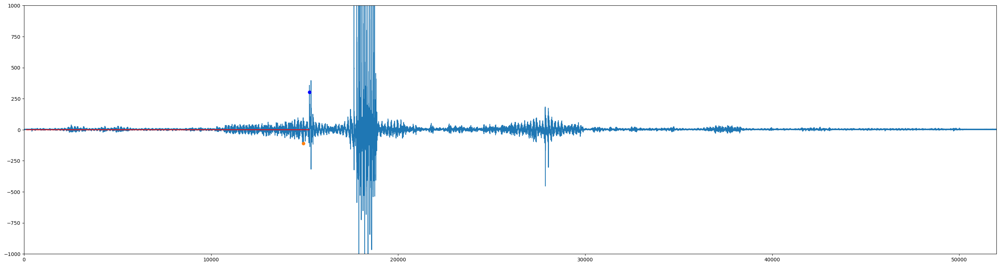

syt max_pos:(14887, 516.375)
syt start/end_pos:(112, 15239)


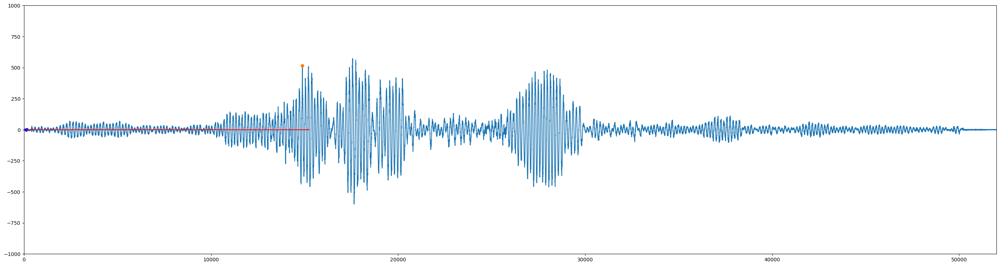

m_head_vel max_dif:([519    15142
Name: x, dtype: int64, 519    15055.0
Name: lag_x, dtype: float64], [519    1.390768e-09
Name: y, dtype: float64, 519   -2.170820e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([614    18394
Name: x, dtype: int64, 614    18386.0
Name: lag_x, dtype: float64], [614    9.449451e-09
Name: y, dtype: float64, 614   -5.840675e-09
Name: lag_y, dtype: float64])


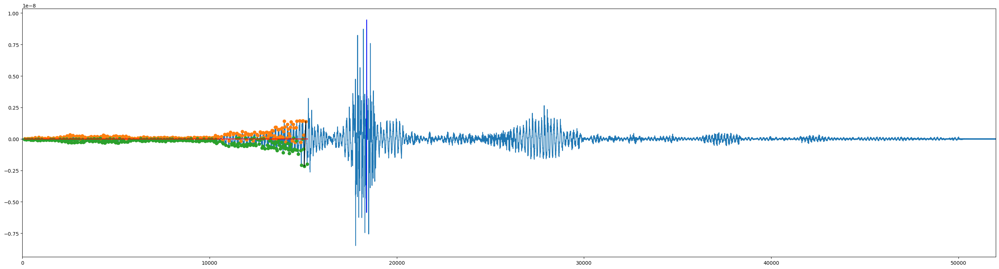

ot_vel max_dif:
ot_vel_whole max_dif:


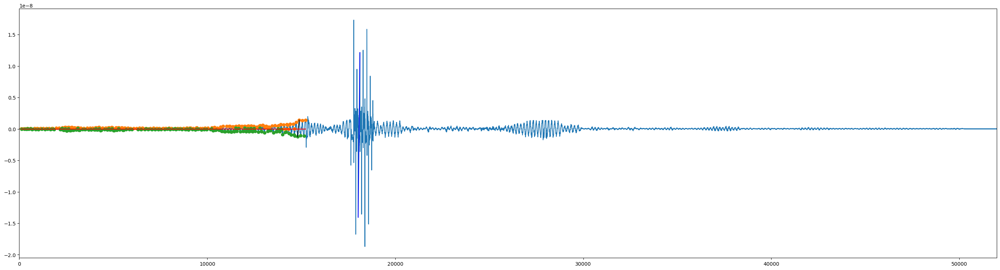

sty_vel_whole max_dif:


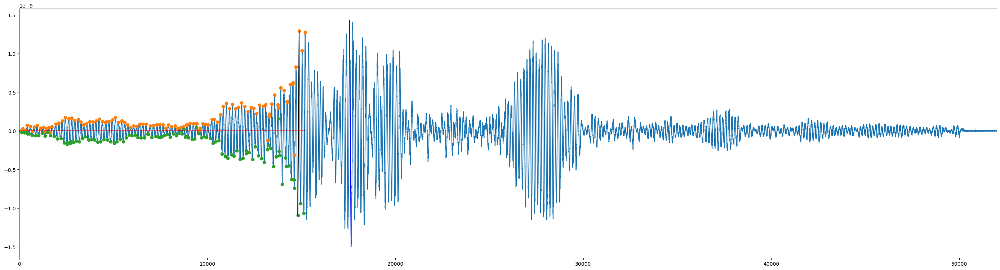

{'Index': 8, 'number': 8.0, 'experiment_number': 3.0, 'accentulation_number': 'No7_kobe070.CSV', 'movie_number': '2-7', 'seismic_wave': 'Kobe', 'output': 70.0, 'movement': 'なし', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': 'なし', 'time_to_rocking': nan, 'position': '頭低位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-B', 'floor': 'Concrete', 'is_rock_or_down': False}
eval_span:0.015_55.9
eval_ind:3_11180
time to rock:55.885
m_head max_pos:(2123, 1177.02)
m_head_whole max_pos:(2123, 1177.02)


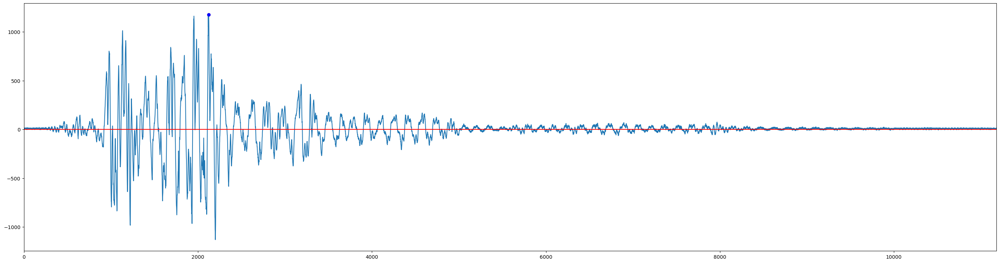

ot max_pos:(1146, -823.879)
ot_whole max_pos:(1146, -823.879)


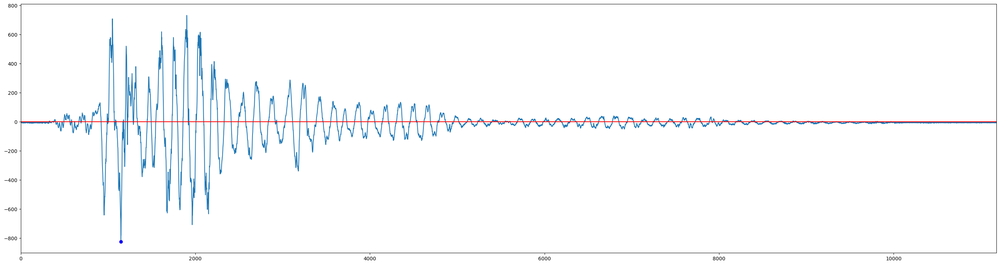

otz max_pos:(1918, 255.72)


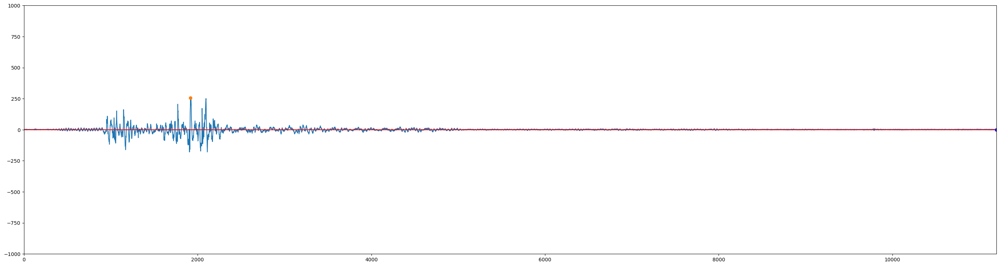

syt max_pos:(1669, -702.75)
syt start/end_pos:(3, 11180)


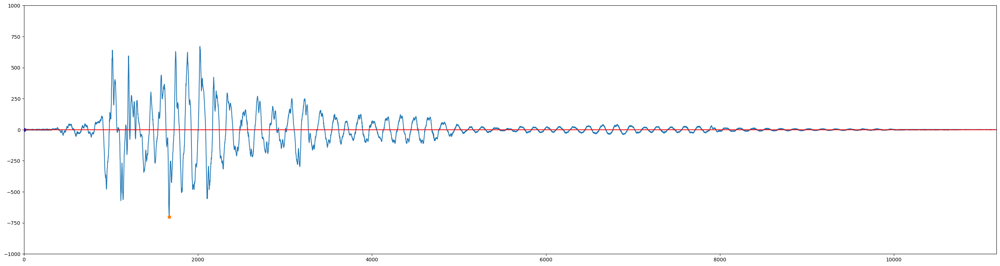

m_head_vel max_dif:([86    2200
Name: x, dtype: int64, 86    2123.0
Name: lag_x, dtype: float64], [86   -2.825950e-09
Name: y, dtype: float64, 86    2.942550e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([86    2200
Name: x, dtype: int64, 86    2123.0
Name: lag_x, dtype: float64], [86   -2.825950e-09
Name: y, dtype: float64, 86    2.942550e-09
Name: lag_y, dtype: float64])


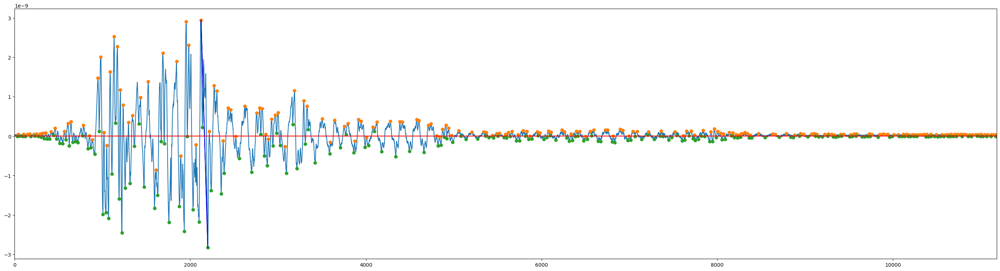

ot_vel max_dif:
ot_vel_whole max_dif:


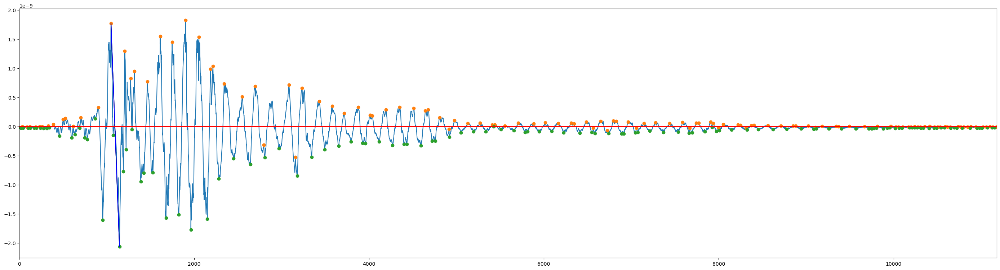

sty_vel_whole max_dif:


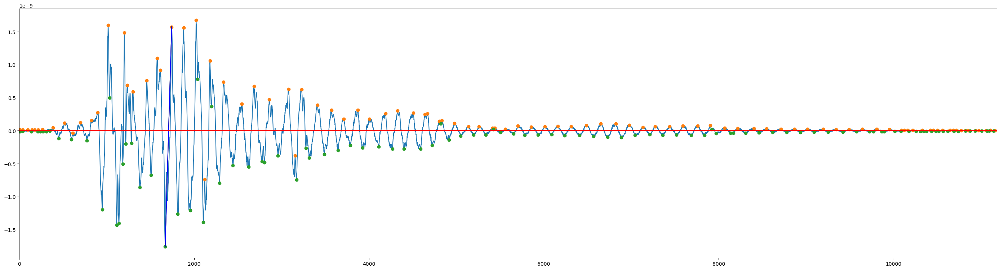

{'Index': 9, 'number': 9.0, 'experiment_number': 3.0, 'accentulation_number': 'No7_OS2_070.CSV', 'movie_number': '2-8', 'seismic_wave': 'OS2', 'output': 70.0, 'movement': 'なし', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': nan, 'time_to_rocking': nan, 'position': '頭低位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-B', 'floor': 'Concrete', 'is_rock_or_down': False}
eval_span:0.32_257.86
eval_ind:64_51572
time to rock:257.54
m_head max_pos:(17834, 830.575)
m_head_whole max_pos:(17834, 830.575)


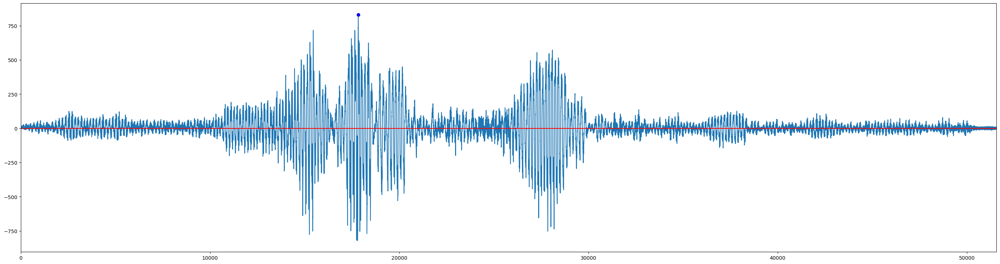

ot max_pos:(17597, 608.954)
ot_whole max_pos:(17597, 608.954)


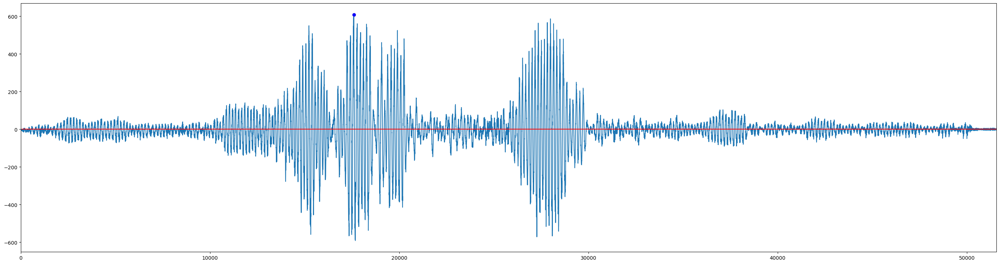

otz max_pos:(17801, 160.903)


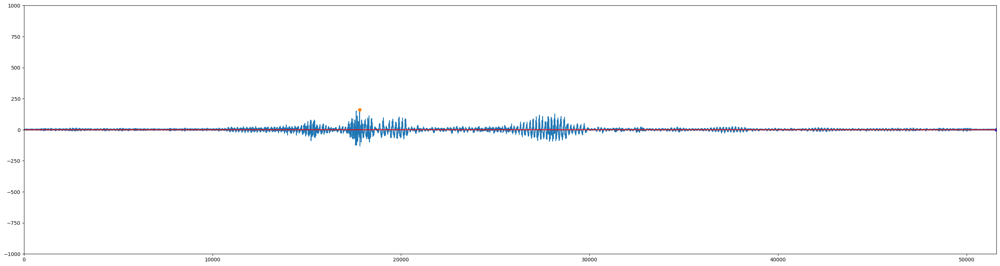

syt max_pos:(17647, -509.625)
syt start/end_pos:(64, 51572)


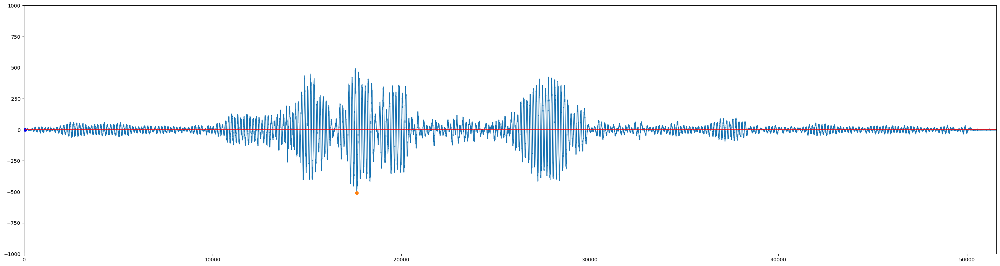

m_head_vel max_dif:([569    17834
Name: x, dtype: int64, 569    17798.0
Name: lag_x, dtype: float64], [569    2.076438e-09
Name: y, dtype: float64, 569   -2.051453e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([573    17834
Name: x, dtype: int64, 573    17798.0
Name: lag_x, dtype: float64], [573    2.076438e-09
Name: y, dtype: float64, 573   -2.051453e-09
Name: lag_y, dtype: float64])


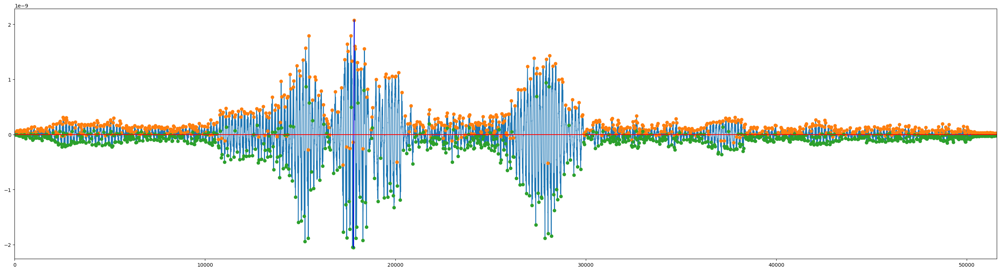

ot_vel max_dif:
ot_vel_whole max_dif:


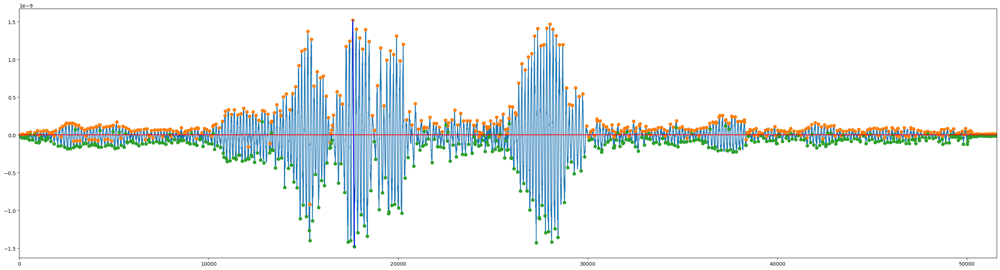

sty_vel_whole max_dif:


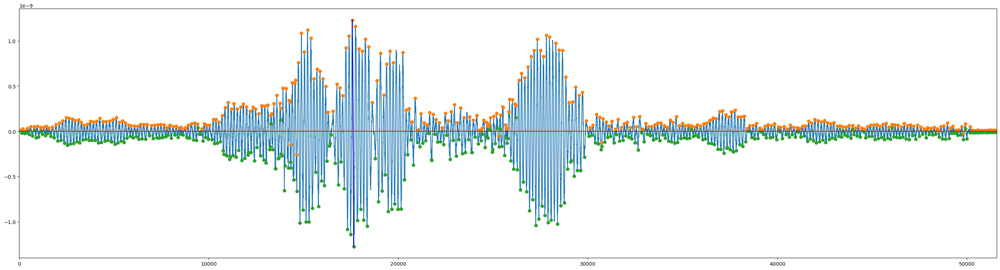

{'Index': 10, 'number': 10.0, 'experiment_number': 3.0, 'accentulation_number': 'No7_OS2_080.CSV', 'movie_number': '2-9', 'seismic_wave': 'OS2', 'output': 80.0, 'movement': 'なし', '備考': '柵に当たる', 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': nan, 'time_to_rocking': nan, 'position': '頭低位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-B', 'floor': 'Concrete', 'is_rock_or_down': False}
eval_span:0.525_256.94
eval_ind:105_51388
time to rock:256.415
m_head max_pos:(17843, 1092.63)
m_head_whole max_pos:(17843, 1092.63)


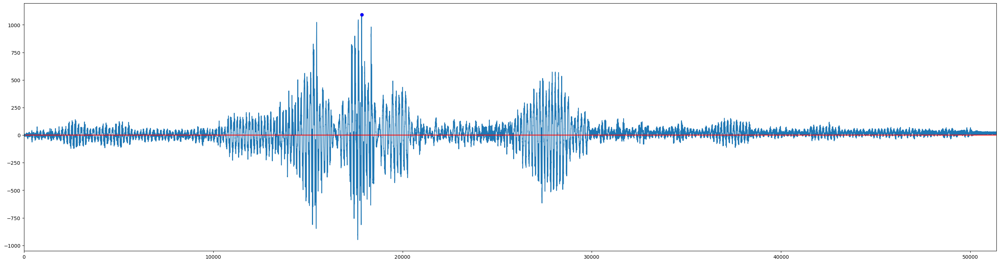

ot max_pos:(15224, 660.78)
ot_whole max_pos:(15224, 660.78)


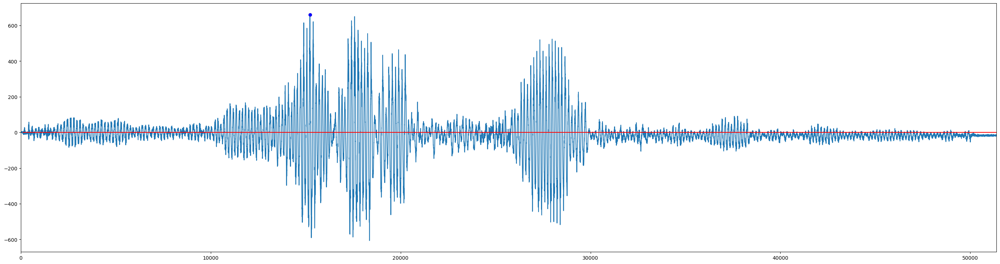

otz max_pos:(17650, -331.143)


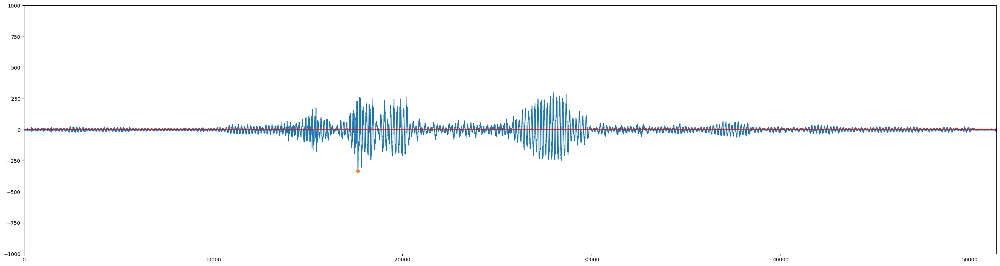

syt max_pos:(17648, -603.375)
syt start/end_pos:(105, 51388)


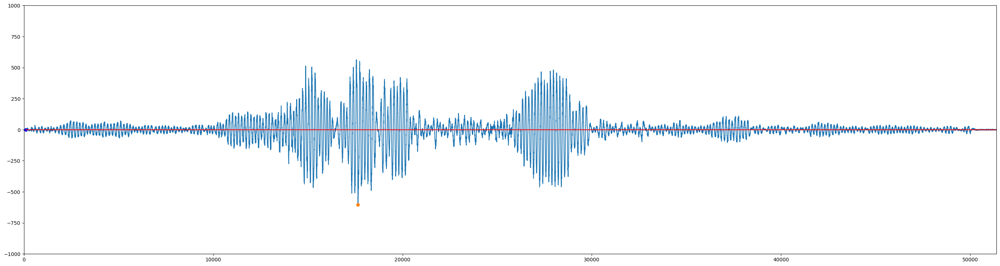

m_head_vel max_dif:([571    17662
Name: x, dtype: int64, 571    17637.0
Name: lag_x, dtype: float64], [571    2.612200e-09
Name: y, dtype: float64, 571   -2.370690e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([574    17662
Name: x, dtype: int64, 574    17637.0
Name: lag_x, dtype: float64], [574    2.612200e-09
Name: y, dtype: float64, 574   -2.370690e-09
Name: lag_y, dtype: float64])


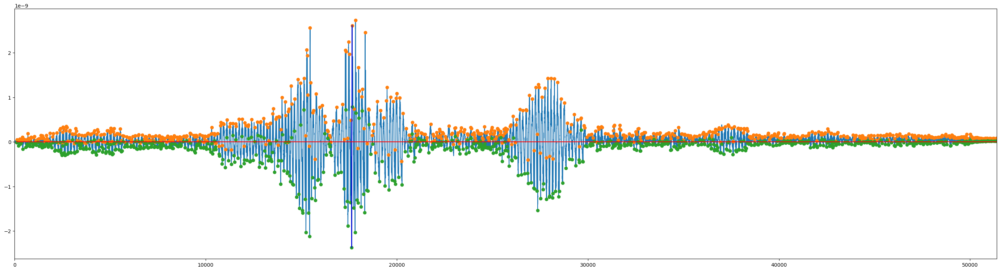

ot_vel max_dif:
ot_vel_whole max_dif:


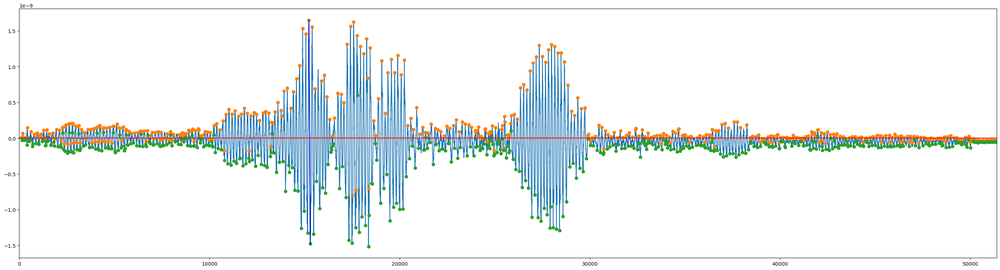

sty_vel_whole max_dif:


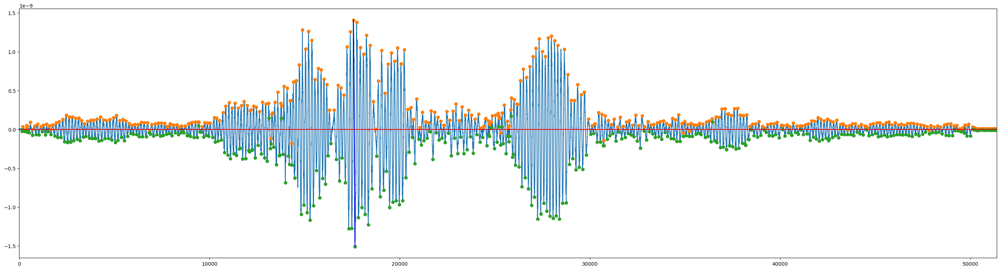

{'Index': 11, 'number': 11.0, 'experiment_number': 4.0, 'accentulation_number': 'No8_kobe070.CSV', 'movie_number': '2-11', 'seismic_wave': 'Kobe', 'output': 70.0, 'movement': 'なし', '備考': nan, 'operating_table': 'Ay5', 'mannequine_head': 'Ay9', '_11': nan, 'time_to_rocking': nan, 'position': '頭低位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax6', 'OT_tpye': 'OT-A', 'floor': 'Floor material', 'is_rock_or_down': False}
eval_span:0.15_55.08
eval_ind:30_11016
time to rock:54.93
m_head max_pos:(1253, 3343.4)
m_head_whole max_pos:(1253, 3343.4)


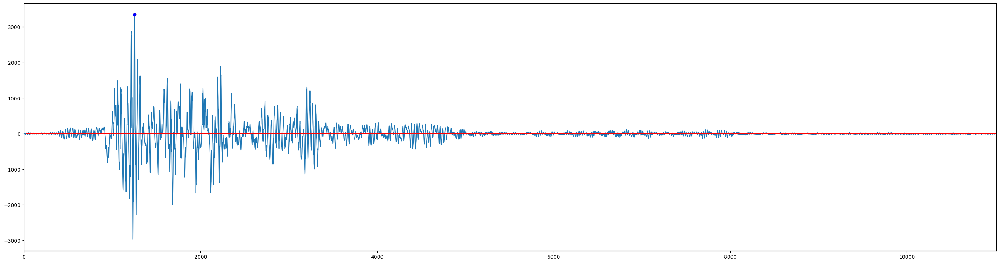

ot max_pos:(1952, -805.89)
ot_whole max_pos:(1952, -805.89)


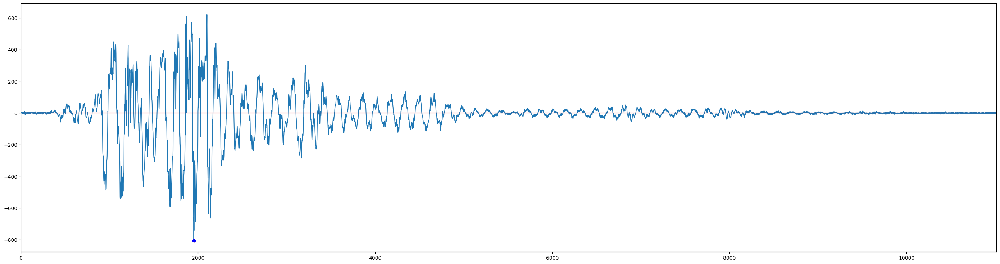

otz max_pos:(1859, 412.185)


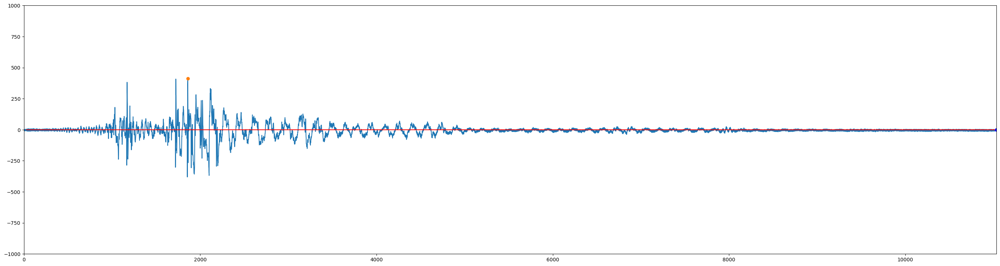

syt max_pos:(1668, -706.125)
syt start/end_pos:(30, 11016)


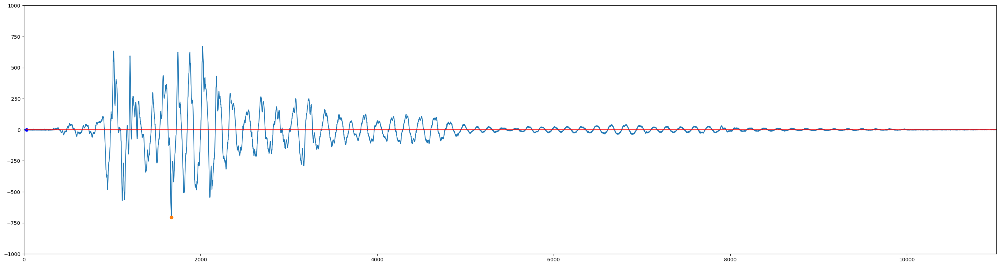

m_head_vel max_dif:([44    1253
Name: x, dtype: int64, 44    1235.0
Name: lag_x, dtype: float64], [44    8.358501e-09
Name: y, dtype: float64, 44   -7.447976e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([44    1253
Name: x, dtype: int64, 44    1235.0
Name: lag_x, dtype: float64], [44    8.358501e-09
Name: y, dtype: float64, 44   -7.447976e-09
Name: lag_y, dtype: float64])


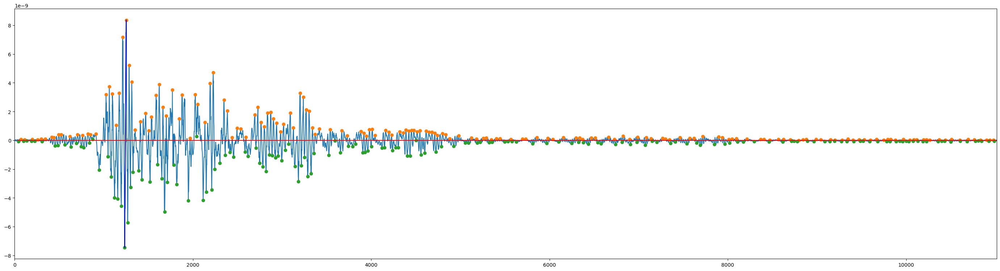

ot_vel max_dif:
ot_vel_whole max_dif:


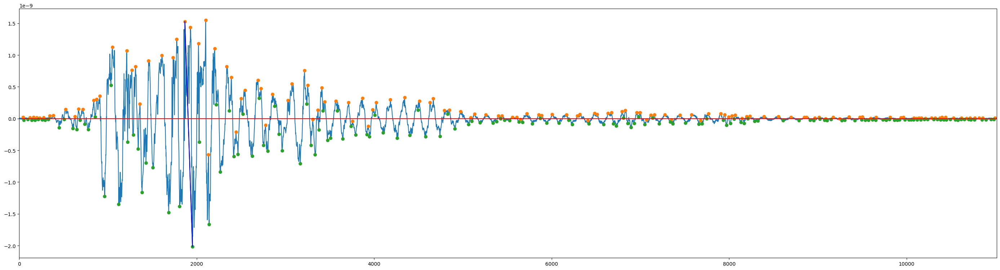

sty_vel_whole max_dif:


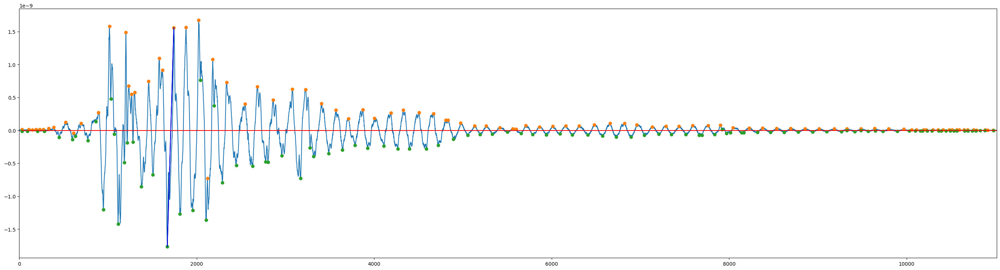

{'Index': 12, 'number': 12.0, 'experiment_number': 4.0, 'accentulation_number': 'No8_OS2_070.CSV', 'movie_number': '2-12', 'seismic_wave': 'OS2', 'output': 70.0, 'movement': 'なし', '備考': '柵に当たる', 'operating_table': 'Ay5', 'mannequine_head': 'Ay9', '_11': '1分32秒', 'time_to_rocking': 92.0, 'position': '頭低位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax6', 'OT_tpye': 'OT-A', 'floor': 'Floor material', 'is_rock_or_down': False}
eval_span:0.045_257.02
eval_ind:9_51404
time to rock:256.97499999999997
m_head max_pos:(17741, 1600.08)
m_head_whole max_pos:(17741, 1600.08)


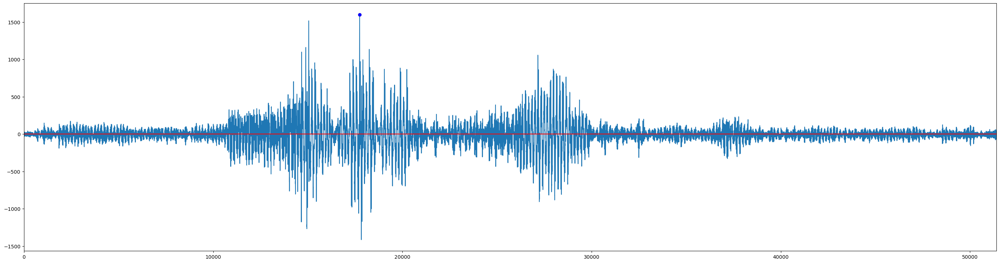

ot max_pos:(17829, -567.961)
ot_whole max_pos:(17829, -567.961)


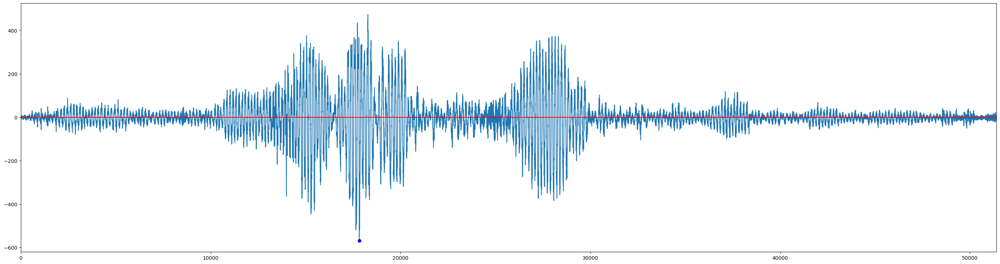

otz max_pos:(17827, 362.223)


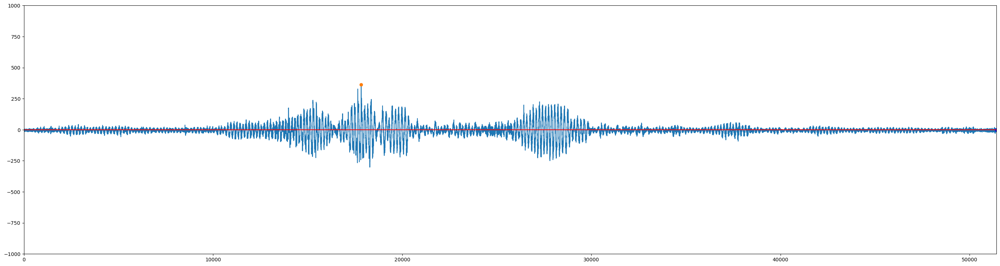

syt max_pos:(17647, -509.625)
syt start/end_pos:(9, 51404)


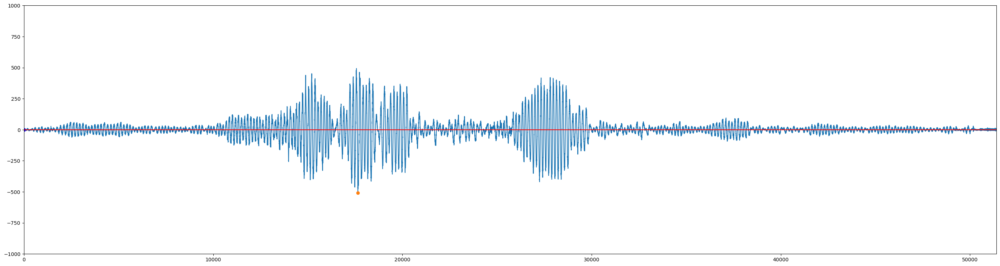

m_head_vel max_dif:([519    17832
Name: x, dtype: int64, 519    17775.0
Name: lag_x, dtype: float64], [519   -3.536600e-09
Name: y, dtype: float64, 519    2.426210e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([520    17832
Name: x, dtype: int64, 520    17775.0
Name: lag_x, dtype: float64], [520   -3.536600e-09
Name: y, dtype: float64, 520    2.426210e-09
Name: lag_y, dtype: float64])


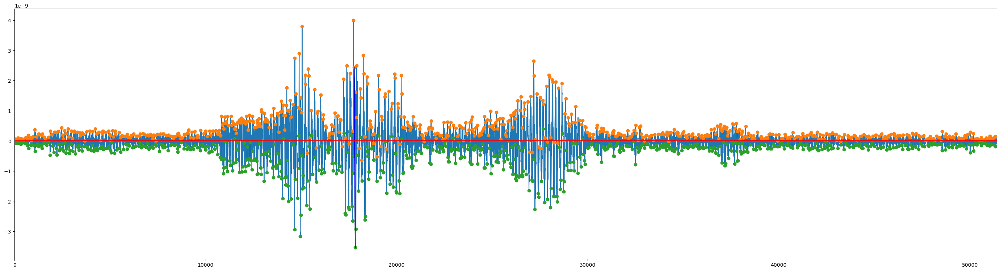

ot_vel max_dif:
ot_vel_whole max_dif:


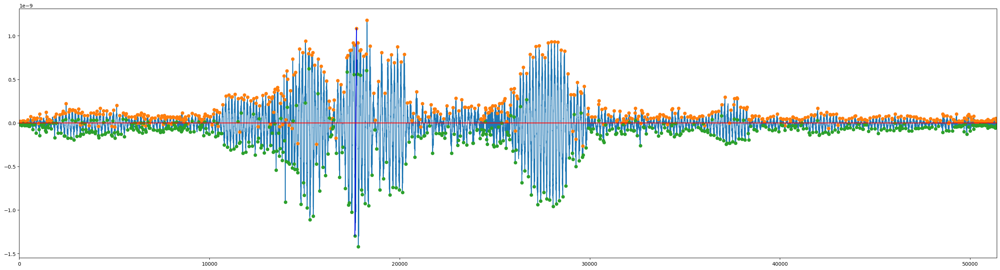

sty_vel_whole max_dif:


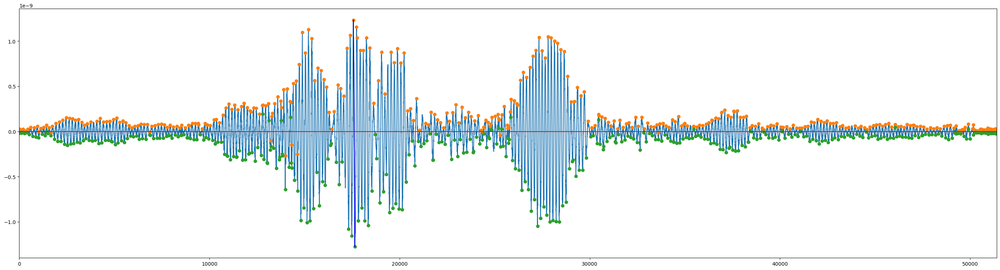

{'Index': 13, 'number': 13.0, 'experiment_number': 4.0, 'accentulation_number': 'No8_OS2_080.CSV', 'movie_number': '2-13', 'seismic_wave': 'OS2', 'output': 80.0, 'movement': '×', '備考': '柵に当たる', 'operating_table': 'Ay5', 'mannequine_head': 'Ay9', '_11': nan, 'time_to_rocking': nan, 'position': '頭低位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax6', 'OT_tpye': 'OT-A', 'floor': 'Floor material', 'is_rock_or_down': False}
eval_span:0.315_256.045
eval_ind:63_51209
time to rock:255.73000000000002
m_head max_pos:(17738, 1611.18)
m_head_whole max_pos:(17738, 1611.18)


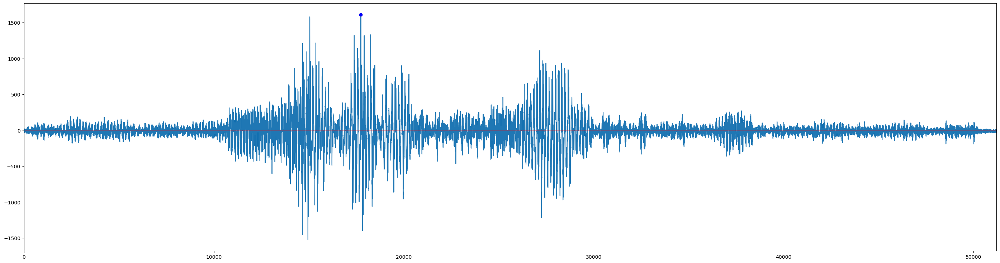

ot max_pos:(17751, 720.185)
ot_whole max_pos:(17751, 720.185)


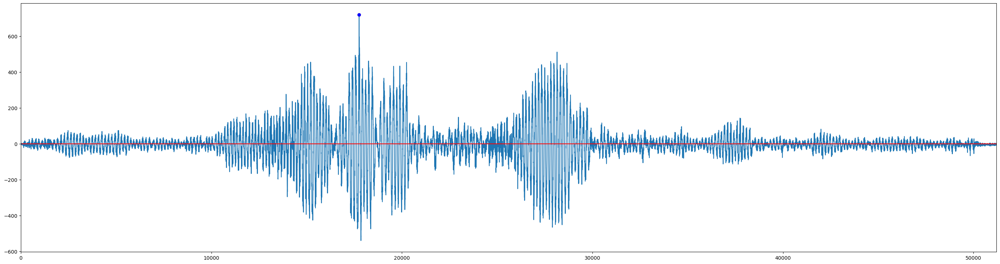

otz max_pos:(17753, -369.509)


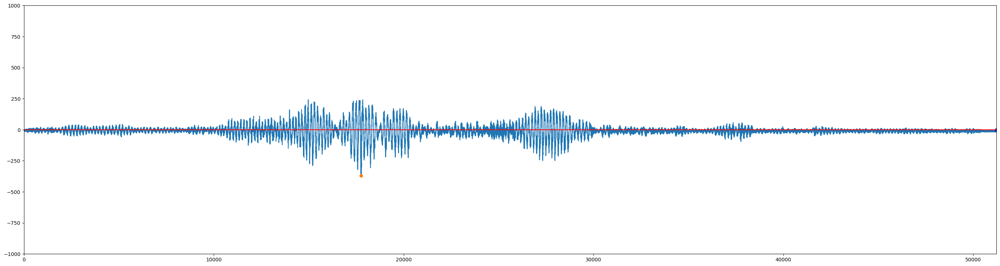

syt max_pos:(17649, -594.375)
syt start/end_pos:(63, 51209)


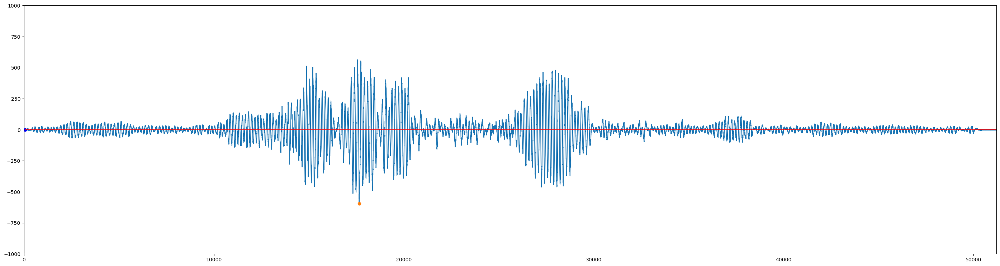

m_head_vel max_dif:([492    17832
Name: x, dtype: int64, 492    17738.0
Name: lag_x, dtype: float64], [492   -3.497750e-09
Name: y, dtype: float64, 492    4.027951e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([494    17832
Name: x, dtype: int64, 494    17738.0
Name: lag_x, dtype: float64], [494   -3.497750e-09
Name: y, dtype: float64, 494    4.027951e-09
Name: lag_y, dtype: float64])


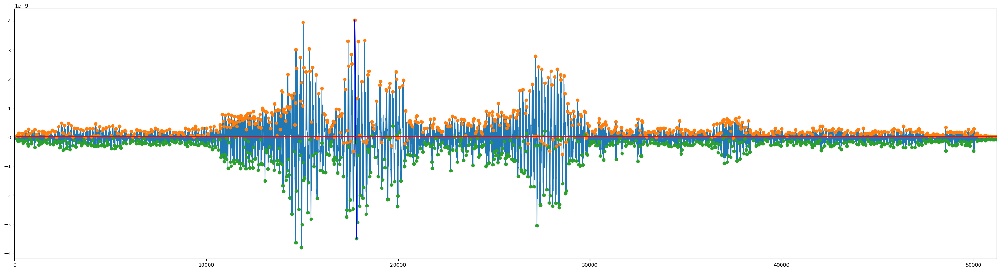

ot_vel max_dif:
ot_vel_whole max_dif:


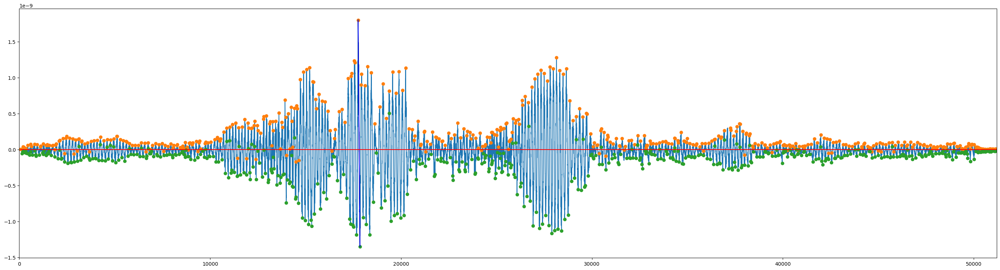

sty_vel_whole max_dif:


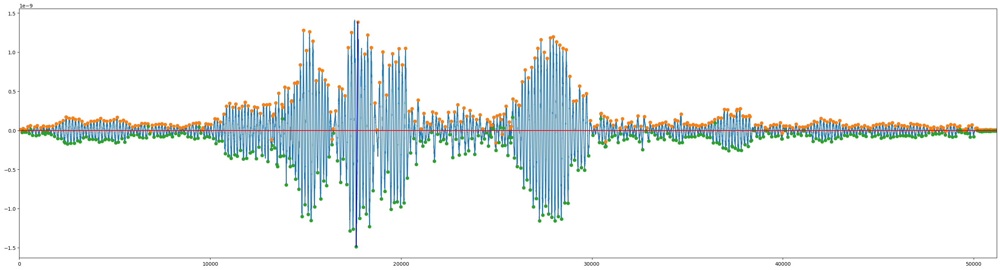

{'Index': 14, 'number': 14.0, 'experiment_number': 5.0, 'accentulation_number': 'No6_kobe070.CSV', 'movie_number': '2-2', 'seismic_wave': 'Kobe', 'output': 70.0, 'movement': 'ロッキング', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': '8秒', 'time_to_rocking': 8.0, 'position': '仰臥位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-B', 'floor': 'Concrete', 'is_rock_or_down': True}
eval_span:0.195_9.605
eval_ind:39_1921
time to rock:9.41
m_head max_pos:(1657, 1103.73)
m_head_whole max_pos:(2296, -2230.78)


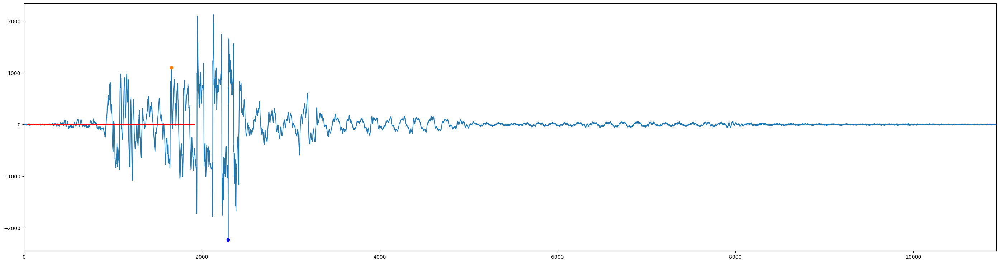

ot max_pos:(1044, 838.36)
ot_whole max_pos:(2294, -3980.69)


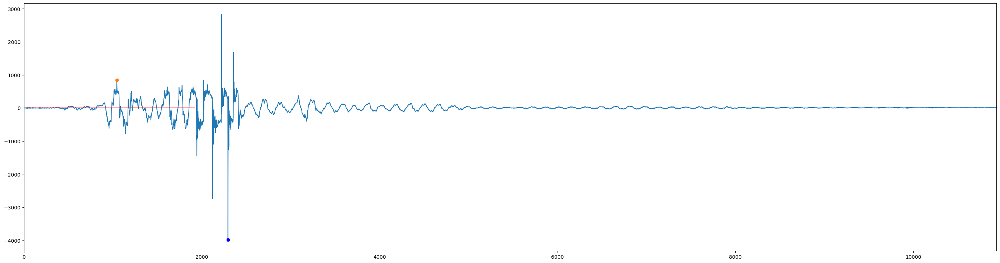

otz max_pos:(1789, 140.071)
rock_pos:(1941, -264.34)
shake_pos:(39, 1941)


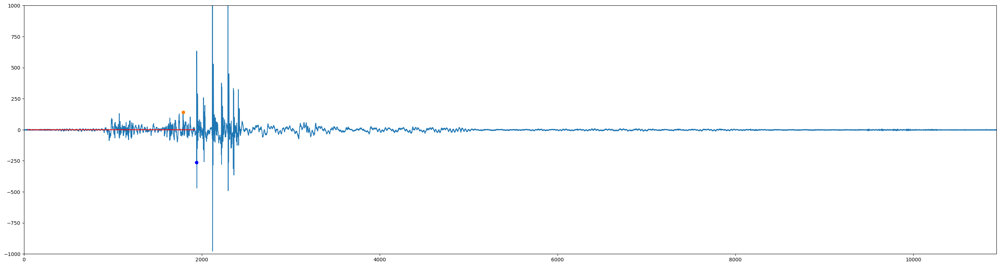

syt max_pos:(1668, -721.875)
syt start/end_pos:(39, 1921)


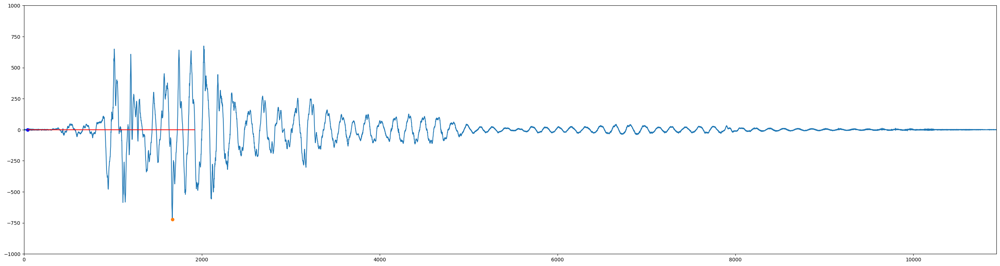

m_head_vel max_dif:([62    1657
Name: x, dtype: int64, 62    1641.0
Name: lag_x, dtype: float64], [62    2.759325e-09
Name: y, dtype: float64, 62   -2.095868e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([79    2128
Name: x, dtype: int64, 79    2121.0
Name: lag_x, dtype: float64], [79    5.313226e-09
Name: y, dtype: float64, 79   -4.452675e-09
Name: lag_y, dtype: float64])


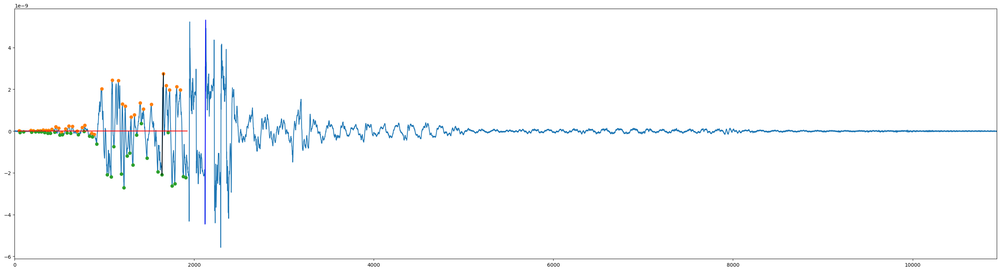

ot_vel max_dif:
ot_vel_whole max_dif:


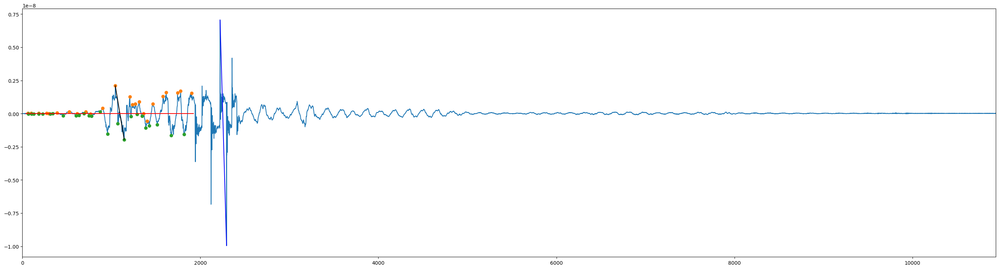

sty_vel_whole max_dif:


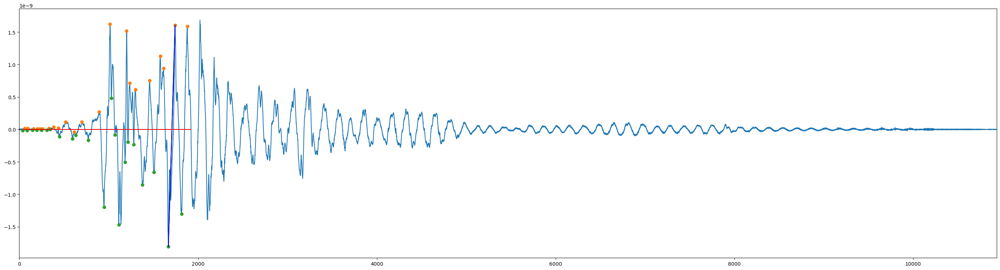

{'Index': 15, 'number': 15.0, 'experiment_number': 5.0, 'accentulation_number': 'No6_OS2_070.CSV', 'movie_number': '2-4', 'seismic_wave': 'OS2', 'output': 70.0, 'movement': 'なし', '備考': nan, 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': nan, 'time_to_rocking': nan, 'position': '仰臥位', 'Mizuho': '確認', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-B', 'floor': 'Concrete', 'is_rock_or_down': False}
eval_span:0.55_256.86
eval_ind:110_51372
time to rock:256.31
m_head max_pos:(17775, -1033.78)
m_head_whole max_pos:(17775, -1033.78)


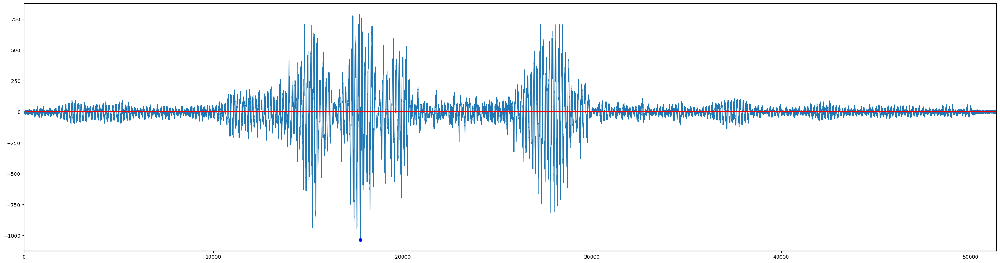

ot max_pos:(15312, -659.256)
ot_whole max_pos:(15312, -659.256)


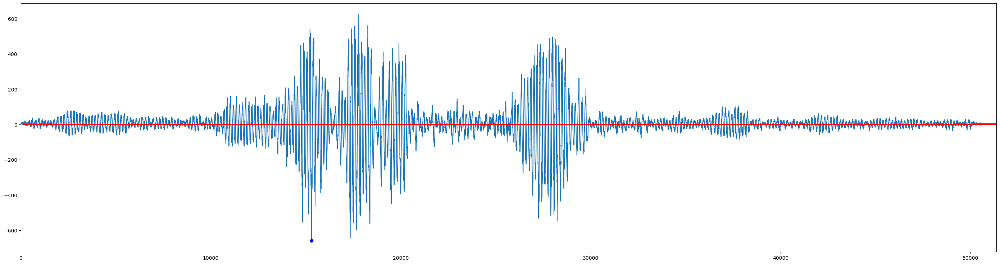

otz max_pos:(28313, -236.326)


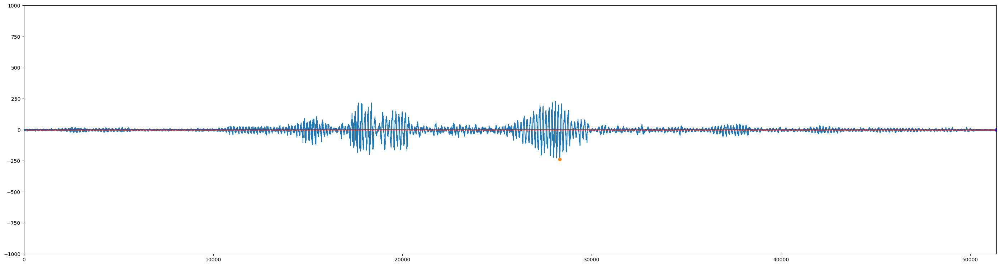

syt max_pos:(17647, -508.125)
syt start/end_pos:(110, 51372)


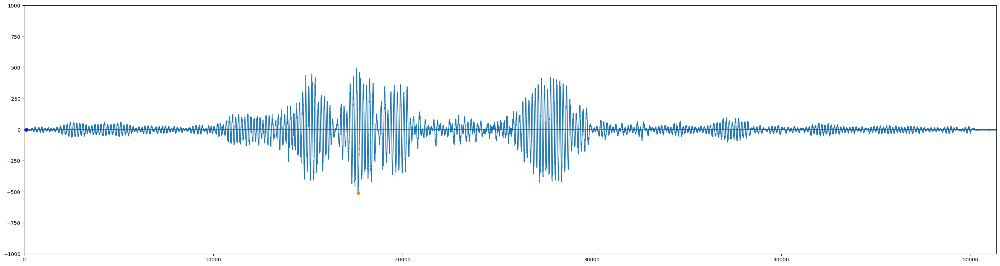

m_head_vel max_dif:([498    17775
Name: x, dtype: int64, 498    17720.0
Name: lag_x, dtype: float64], [498   -2.584450e-09
Name: y, dtype: float64, 498    1.962623e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([504    17775
Name: x, dtype: int64, 504    17720.0
Name: lag_x, dtype: float64], [504   -2.584450e-09
Name: y, dtype: float64, 504    1.962623e-09
Name: lag_y, dtype: float64])


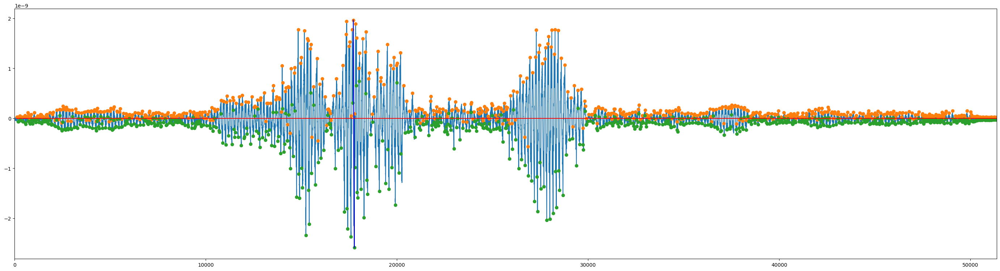

ot_vel max_dif:
ot_vel_whole max_dif:


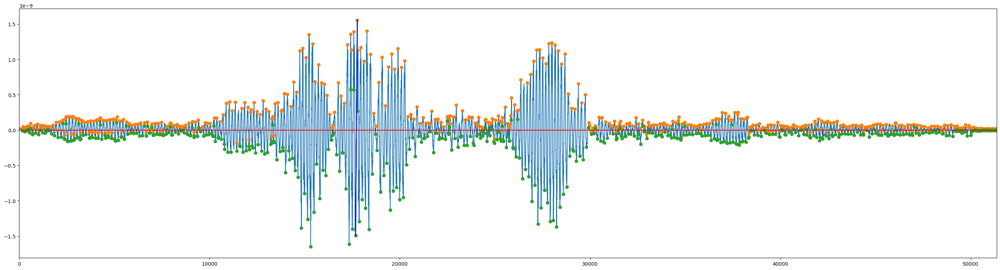

sty_vel_whole max_dif:


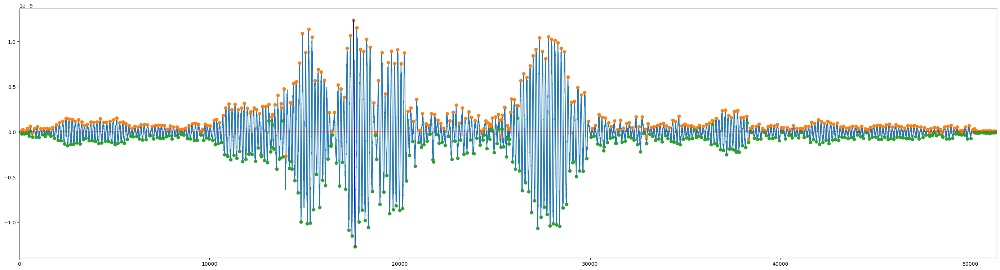

{'Index': 16, 'number': 16.0, 'experiment_number': 5.0, 'accentulation_number': 'No6_OS2_080.CSV', 'movie_number': '2-5', 'seismic_wave': 'OS2', 'output': 80.0, 'movement': 'ロッキング', '備考': '柵に当たる', 'operating_table': 'Ay1', 'mannequine_head': 'Ay9', '_11': '1分30秒', 'time_to_rocking': 90.0, 'position': '仰臥位', 'Mizuho': '×', '堤動画': '確認', 'zval_ot': 'Ax2', 'OT_tpye': 'OT-B', 'floor': 'Concrete', 'is_rock_or_down': True}
eval_span:0.555_74.55
eval_ind:111_14910
time to rock:73.99499999999999
m_head max_pos:(14867, -1110.39)
m_head_whole max_pos:(15499, -2873.7)


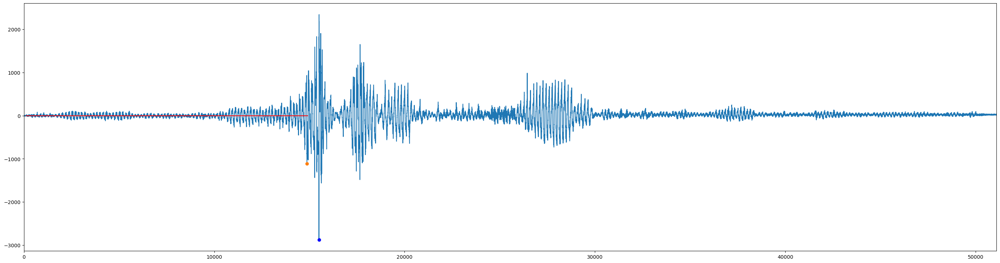

ot max_pos:(14890, 739.281)
ot_whole max_pos:(15497, -6861.59)


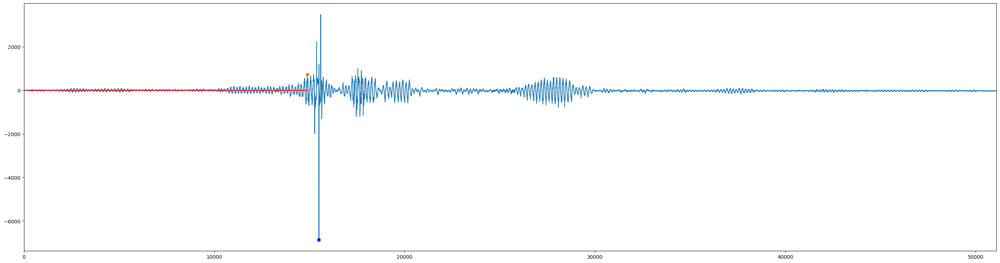

otz max_pos:(14867, 132.17)
rock_pos:(14930, 284.453)
shake_pos:(111, 14930)


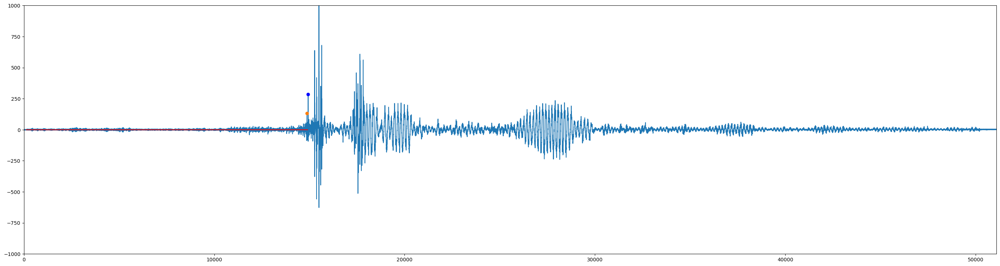

syt max_pos:(14886, 520.875)
syt start/end_pos:(111, 14910)


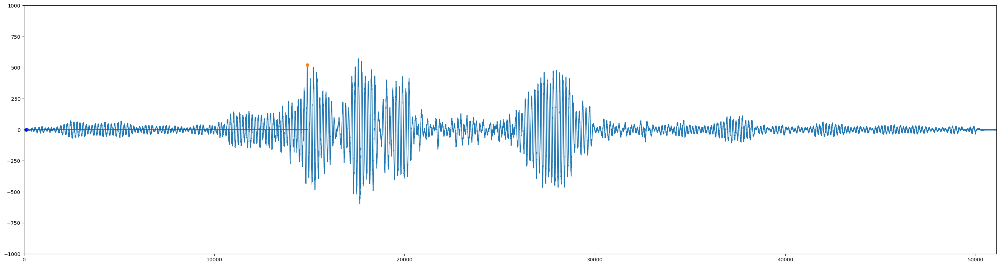

m_head_vel max_dif:([446    14867
Name: x, dtype: int64, 446    14851.0
Name: lag_x, dtype: float64], [446   -2.775975e-09
Name: y, dtype: float64, 446    2.329053e-09
Name: lag_y, dtype: float64])
m_head_vel_whole max_dif:([469    15505
Name: x, dtype: int64, 469    15499.0
Name: lag_x, dtype: float64], [469    5.854550e-09
Name: y, dtype: float64, 469   -7.184250e-09
Name: lag_y, dtype: float64])


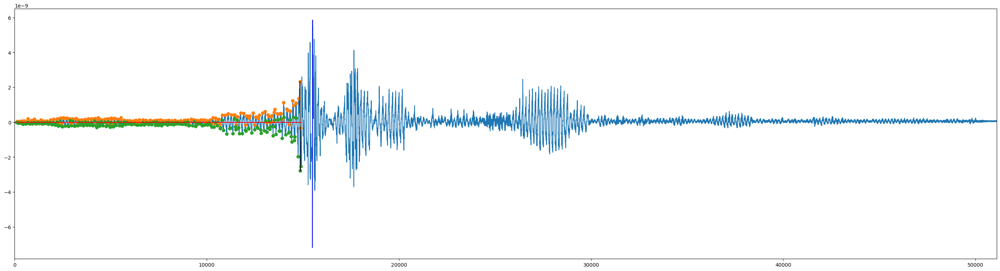

ot_vel max_dif:
ot_vel_whole max_dif:


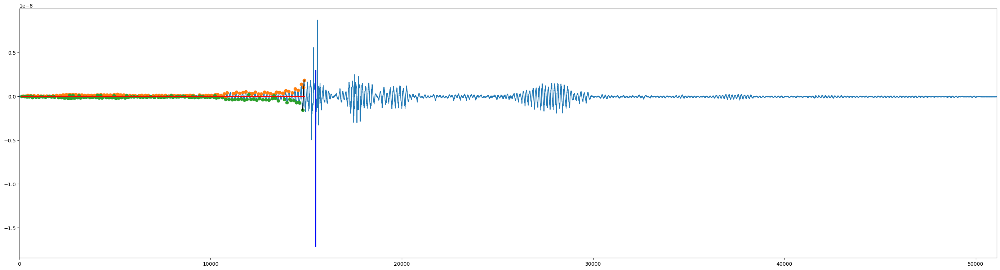

sty_vel_whole max_dif:


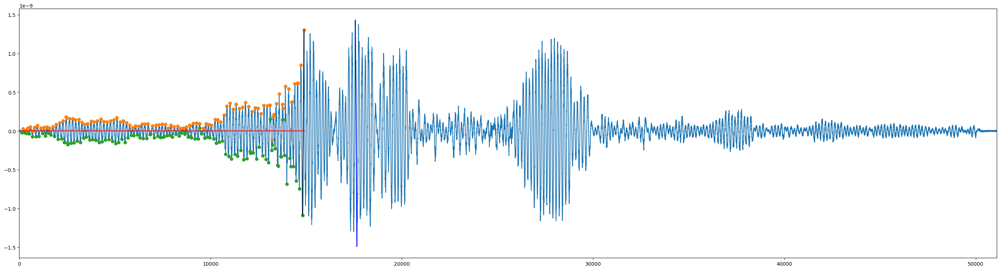

CPU times: user 46.8 s, sys: 610 ms, total: 47.4 s
Wall time: 47.8 s


In [27]:
%%time
d_in_fs = "./201912_kyoto_uni_kurata_iryou/measurement/"

d_res = dict()
sr = 200
span_pre_rock = 0.1
cutoff_rocking = 200

cutoff_shaking = 5

#column about shaking table y
tag_sty = "T_acc_Y"


for i, r in enumerate(df_desmat.itertuples()):
    rd = r._asdict()
    print(rd)
    f_input = d_in_fs + r.accentulation_number
    tag_m = r.mannequine_head
    tag_ot = r.operating_table
    tag_otz = r.zval_ot
    # print(r)
    # print(tag_m, tag_ot)
    # print(f_input)
    
    #load csv
    temp = pd.read_csv(f_input, encoding='ShiftJIS', header=3,low_memory=False)
    df = pd.read_csv(f_input, encoding='ShiftJIS', header=7)
    df.columns = temp.columns
    
    #load acc
    acc_m = df[tag_m].to_numpy()
    acc_ot = df[tag_ot].to_numpy()
    acc_otz = df[tag_otz].to_numpy()
    acc_sty = df[tag_sty].to_numpy()
    
    rocking_start = get_abs_above_x_1st(acc_otz, cutoff_rocking)
    
    # create velo array
    vel_m = get_vel_from_acc(acc_m)
    vel_ot = get_vel_from_acc(acc_ot)
    vel_sty = get_vel_from_acc(acc_sty)
    
    #load disp
    mv_sk = df["T_disp_Y"].to_numpy()
    
    rd["df"] = df
    rd["acc_m"] = acc_m
    rd["acc_ot"] = acc_ot
    rd["acc_otz"] = acc_otz
    rd["acc_sty"] = acc_sty
    
    rd["vel_m"] = vel_m
    rd["vel_ot"] = vel_ot
    rd["vel_sty"] = vel_sty
    rd["mv_sk"] =mv_sk
    
    #define start and end
    if r.is_rock_or_down:
        ind_rock = np.argmax(np.abs(acc_otz) > cutoff_rocking)
        val_rock = acc_otz[ind_rock]
        ind_start = np.argmax(np.abs(acc_sty) > cutoff_shaking)
        sec_start = ind_start/sr
        
        eval_span_ind = ind_rock - ind_start
        eval_span_sec = eval_span_ind/sr
        # ind_shake_start = np.argmax(np.abs(acc_sty) > cutoff_shaking)
    else:
        ind_rock = len(mv_sk) + int(span_pre_rock * sr)
        val_rock = 0
        ind_start = np.argmax(np.abs(acc_sty) > cutoff_shaking)
        sec_start = ind_start/sr
        # ind_shake_start = np.argmax(np.abs(acc_sty) > cutoff_shaking)
        eval_span_ind = 0
        eval_span_sec = 0
        
    ind_1st_rock_pre = ind_rock - int(span_pre_rock * sr)
    ind_1st_rock_post = ind_rock + int(span_pre_rock * sr)
    
    
    ind_end = ind_rock - int(span_pre_rock * sr)
    # idn_end = ind_rock - (span_pre_rock * sr)
    #define if end is NA
    if ind_end <= 0:
        ind_end = len(mv_sk)
    sec_end = ind_end/sr
    
    print("eval_span:{}_{}".format(sec_start, sec_end))
    print("eval_ind:{}_{}".format(ind_start, ind_end))
    print("time to rock:{}".format(sec_end - sec_start))
    
    rd["sr"] = sr
    rd["sec_start"] = sec_start
    rd["sec_end"] = sec_end
    rd["ind_start"] = ind_start
    rd["ind_end"] = ind_end
    rd["eval_span_sec"] = eval_span_sec
    rd["eval_span_ind"] = eval_span_ind
    
    # cut array for eval
    ## fill zero
    acc_m_lim = fill_arr_zero(acc_m, ind_start, ind_end)
    acc_ot_lim = fill_arr_zero(acc_ot, ind_start, ind_end)
    acc_otz_lim = fill_arr_zero(acc_otz, ind_start, ind_end)
    acc_sty_lim = fill_arr_zero(acc_sty, ind_start, ind_end)
    
    
    vel_m_lim = fill_arr_zero(vel_m, ind_start, ind_end)
    vel_ot_lim = fill_arr_zero(vel_ot, ind_start, ind_end)
    vel_sty_lim = fill_arr_zero(vel_sty, ind_start, ind_end)
    
    # define max abs acc
    rd["m_abs_max_acc"] = get_max_abs_pos(acc_m_lim)
    rd["ot_abs_max_acc"] = get_max_abs_pos(acc_ot_lim)
    rd["otz_abs_max_acc"] = get_max_abs_pos(acc_otz_lim)
    rd["sty_abs_max_acc"] = get_max_abs_pos(acc_sty_lim)
    
    # define max abs acc_whole
    rd["m_abs_max_acc_whole"] = get_max_abs_pos(acc_m)
    rd["ot_abs_max_acc_whole"] = get_max_abs_pos(acc_ot)
    rd["sty_abs_max_acc_whole"] = get_max_abs_pos(acc_sty)
    
    #vis
    print("m_head max_pos:{}".format((rd["m_abs_max_acc"]["max_abs_ind"], rd["m_abs_max_acc"]["max_val"])))
    print("m_head_whole max_pos:{}".format((rd["m_abs_max_acc_whole"]["max_abs_ind"], rd["m_abs_max_acc_whole"]["max_val"])))
    vis_acc_abs_mx(arr=rd["acc_m"], 
                   max_pos=(rd["m_abs_max_acc"]["max_abs_ind"], rd["m_abs_max_acc"]["max_val"]),
                   span_range=(rd["ind_start"],rd["ind_end"]),
                   opt_point = (rd["m_abs_max_acc_whole"]["max_abs_ind"], rd["m_abs_max_acc_whole"]["max_val"]))
    
    print("ot max_pos:{}".format((rd["ot_abs_max_acc"]["max_abs_ind"], rd["ot_abs_max_acc"]["max_val"])))
    print("ot_whole max_pos:{}".format((rd["ot_abs_max_acc_whole"]["max_abs_ind"], rd["ot_abs_max_acc_whole"]["max_val"])))
    vis_acc_abs_mx(arr=rd["acc_ot"], 
                   max_pos=(rd["ot_abs_max_acc"]["max_abs_ind"], rd["ot_abs_max_acc"]["max_val"]),
                   span_range=(rd["ind_start"],rd["ind_end"]),
                   opt_point=(rd["ot_abs_max_acc_whole"]["max_abs_ind"], rd["ot_abs_max_acc_whole"]["max_val"]))

    print("otz max_pos:{}".format((rd["otz_abs_max_acc"]["max_abs_ind"], rd["otz_abs_max_acc"]["max_val"])))
    if r.is_rock_or_down:
        print("rock_pos:{}".format((ind_rock, val_rock)))
        print("shake_pos:{}".format((ind_start, ind_rock)))
        
    vis_acc_abs_mx(arr=rd["acc_otz"], 
                   max_pos=(rd["otz_abs_max_acc"]["max_abs_ind"], rd["otz_abs_max_acc"]["max_val"]),
                   span_range=(rd["ind_start"],rd["ind_end"]),
                   ylim = (-1000, 1000),
                   opt_point = (ind_rock, val_rock))
    
    print("syt max_pos:{}".format((rd["sty_abs_max_acc"]["max_abs_ind"], rd["sty_abs_max_acc"]["max_val"])))
    print("syt start/end_pos:{}".format((ind_start, ind_end)))
    vis_acc_abs_mx(arr=rd["acc_sty"], 
                   max_pos=(rd["sty_abs_max_acc"]["max_abs_ind"], rd["sty_abs_max_acc"]["max_val"]),
                   span_range=(rd["ind_start"],rd["ind_end"]),
                   ylim = (-1000, 1000),
                   opt_point = (ind_start, 0))


    
    
    # define max diff
    rd["m_max_dif_vel"] = get_max_change(vel_m_lim)
    rd["ot_max_dif_vel"] = get_max_change(vel_ot_lim)
    rd["sty_max_dif_vel"] = get_max_change(vel_sty_lim)
    
    # define max diff whole
    rd["m_max_dif_vel_whole"] = get_max_change(vel_m)
    rd["ot_max_dif_vel_whole"] = get_max_change(vel_ot)
    rd["sty_max_dif_vel_whole"] = get_max_change(vel_sty)
    
    #vis
    print("m_head_vel max_dif:{}".format((rd["m_max_dif_vel"]["seg_x"],
                                          rd["m_max_dif_vel"]["seg_y"])))
    print("m_head_vel_whole max_dif:{}".format((rd["m_max_dif_vel_whole"]["seg_x"],
                                                rd["m_max_dif_vel_whole"]["seg_y"])))
    
    vis_mv_change(arr=rd["vel_m"], 
                  seg=(rd["m_max_dif_vel"]["seg_x"],rd["m_max_dif_vel"]["seg_y"]),
                  locs=rd["m_max_dif_vel"]["locs"],
                  span_range=(rd["ind_start"],rd["ind_end"]),
                  opt_seg=(rd["m_max_dif_vel_whole"]["seg_x"],rd["m_max_dif_vel_whole"]["seg_y"]))
    
    print("ot_vel max_dif:".format((rd["ot_max_dif_vel"]["seg_x"],
                                    rd["ot_max_dif_vel"]["seg_y"])))
    
    print("ot_vel_whole max_dif:".format((rd["ot_max_dif_vel_whole"]["seg_x"],
                                          rd["ot_max_dif_vel_whole"]["seg_y"])))
    vis_mv_change(arr=rd["vel_ot"], 
                  seg=(rd["ot_max_dif_vel"]["seg_x"],rd["ot_max_dif_vel"]["seg_y"]),
                  locs=rd["ot_max_dif_vel"]["locs"],
                  span_range=(rd["ind_start"],rd["ind_end"]),
                  opt_seg=(rd["ot_max_dif_vel_whole"]["seg_x"],rd["ot_max_dif_vel_whole"]["seg_y"]))
    
    
    print("sty_vel_whole max_dif:".format((rd["sty_max_dif_vel_whole"]["seg_x"],
                                           rd["sty_max_dif_vel_whole"]["seg_y"])))
    vis_mv_change(arr=rd["vel_sty"], 
                  seg=(rd["sty_max_dif_vel"]["seg_x"],rd["sty_max_dif_vel"]["seg_y"]),
                  locs=rd["sty_max_dif_vel"]["locs"],
                  span_range=(rd["ind_start"],rd["ind_end"]),
                  opt_seg=(rd["sty_max_dif_vel_whole"]["seg_x"],rd["sty_max_dif_vel_whole"]["seg_y"]))
    
    
    rd["acc_m_lim"] = acc_m_lim
    rd["acc_ot_lim"] = acc_ot_lim
    rd["vel_m_lim"] = vel_m_lim
    rd["vel_ot_lim"] = vel_ot_lim
    

    
    d_res[int(r.number)] = rd
    
    # if i == 0:
    #     break

In [24]:
# np.argmax(np.abs(acc_sty) > cutoff_shaking)

In [28]:
f_out = "../dat/d_res_temp_{}.pkl".format(ts)
f_out

'../dat/d_res_temp_20231229_175540_583251.pkl'

In [29]:
d2p(d=d_res, f=f_out)

In [51]:
# d_res_tmp = p2d(f="../dat/d_res_temp.pkl")